<a href="https://colab.research.google.com/github/prashantmalan/NSE/blob/main/Isolation_Forest_20240913.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# prompt: how to mount drive to read csv

from google.colab import drive
drive.mount('/content/drive')
import pandas as pd
import warnings
warnings.filterwarnings('ignore')
dff = pd.read_csv('/content/drive/My Drive/Colab Notebooks/anomaly/Pm_CFTC_2017649.csv')
col_cat=pd.read_csv("/content/drive/My Drive/Colab Notebooks/anomaly/col_cat_5.csv")
dff = dff[~dff.applymap(lambda x: ';' in str(x)).any(axis=1)]
dff.reset_index(drop=True, inplace=True)
dff = dff.applymap(lambda x: str(x).replace(',', '') if isinstance(x, str) else x)
dff = dff.applymap(lambda x: str(x).replace('+', '') if isinstance(x, str) else x)
dff = dff[~dff.applymap(lambda x: ';' in str(x)).any(axis=1)]

for column in dff.columns:
    dff[column + '_dtype'] = dff[column].dtypes
    dff[column + '_d_length'] = dff[column].apply(lambda x: len(str(x)))
    dff[column + '_d_isnull'] = dff[column].isnull()





Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
dff

,Dissemination Identifier,Original Dissemination Identifier,Action type,Event type,Event timestamp,Amendment indicator,Asset Class,Product name,Cleared,Mandatory clearing indicator,...,Delivery Type_d_isnull,Unique Product Identifier_dtype,Unique Product Identifier_d_length,Unique Product Identifier_d_isnull,UPI FISN_dtype,UPI FISN_d_length,UPI FISN_d_isnull,UPI Underlier Name_dtype,UPI Underlier Name_d_length,UPI Underlier Name_d_isnull
0,935752170,NaN,NEWT,TRAD,2024-03-16T01:45:52Z,False,CO,Commodity:Agricultural:GrainsOilSeeds:Swap:Cash,N,False,...,True,float64,3,True,float64,3,True,float64,3,True
1,935752171,NaN,NEWT,TRAD,2024-03-16T01:45:54Z,False,CO,Commodity:Agricultural:GrainsOilSeeds:Swap:Cash,N,False,...,True,float64,3,True,float64,3,True,float64,3,True
2,935752172,NaN,NEWT,TRAD,2024-03-16T01:45:53Z,False,CO,Commodity:Agricultural:GrainsOilSeeds:Swap:Cash,N,False,...,True,float64,3,True,float64,3,True,float64,3,True
3,935752173,NaN,NEWT,TRAD,2024-03-16T01:45:51Z,False,CO,Commodity:Agricultural:GrainsOilSeeds:Swap:Cash,N,False,...,True,float64,3,True,float64,3,True,float64,3,True
4,935752174,NaN,NEWT,TRAD,2024-03-16T01:45:51Z,False,CO,Commodity:Agricultural:GrainsOilSeeds:Swap:Cash,N,False,...,True,float64,3,True,float64,3,True,float64,3,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8525,932650246,NaN,NEWT,TRAD,2024-03-14T01:08:38Z,False,CO,Commodity:Agricultural:GrainsOilSeeds:Swap:Cash,N,False,...,True,float64,3,True,float64,3,True,float64,3,True
8526,932650249,NaN,NEWT,TRAD,2024-03-14T01:08:35Z,False,CO,Commodity:Agricultural:Softs:Swap:Cash,N,False,...,True,float64,3,True,float64,3,True,float64,3,True
8527,932650258,NaN,NEWT,TRAD,2024-03-14T01:08:40Z,False,CO,Commodity:Agricultural:GrainsOilSeeds:Swap:Cash,N,False,...,True,float64,3,True,float64,3,True,float64,3,True
8528,932650265,NaN,NEWT,TRAD,2024-03-14T01:08:41Z,False,CO,Commodity:Agricultural:GrainsOilSeeds:Swap:Cash,N,False,...,True,float64,3,True,float64,3,True,float64,3,True


In [ ]:
# prompt: I have 3 type of data in dff dates ,ids and numeric , I want to make 3 efficient anomaly detection ml models for these 3 kind of data type

import pandas as pd
from sklearn.ensemble import IsolationForest
from sklearn.neighbors import LocalOutlierFactor
from sklearn.preprocessing import MinMaxScaler
import numpy as np


# Separate data based on data type
date_cols = [col for col in dff.columns if '_dtype' in col and str(dff[col].iloc[0]) == 'object']
id_cols = [col for col in dff.columns if '_dtype' in col and str(dff[col].iloc[0]) == 'object']  # Assuming IDs are also objects
numeric_cols = [col for col in dff.columns if '_dtype' in col and str(dff[col].iloc[0]) == 'float64']
numeric_cols_actual = [col.replace('_dtype', '') for col in numeric_cols]
dff['missing_count'] = dff.isnull().sum(axis=1)
# prompt: I want  a lof model for numeric data anamoly , and need to know which feature is contributing to the anomaly, the feature  contribution score is very raw , I want a sophisticated model

# Select only the numeric columns
numeric_df = dff[numeric_cols_actual]


# Scale the data
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(numeric_df)
scaled_data = np.nan_to_num(scaled_data, nan=np.nanmean(scaled_data))

In [ ]:
# prompt: how to tune  the parameters  of lof?

from sklearn.model_selection import GridSearchCV

# Define the parameter grid
param_grid = {
    'n_neighbors': [10, 20, 30, 40, 50],  # Try different values for n_neighbors
    'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],  # Explore different algorithms
    'leaf_size': [20, 30, 40],  # Adjust leaf size for different algorithms
    'metric': ['euclidean', 'manhattan', 'cosine']  # Experiment with different distance metrics
}

# Create the LOF model
lof = LocalOutlierFactor()

# Create GridSearchCV object
grid_search = GridSearchCV(estimator=lof, param_grid=param_grid, cv=5, scoring='neg_mean_squared_error')

# Fit the grid search to the data
grid_search.fit(scaled_data)

# Get the best parameters
best_params = grid_search.best_params_
print("Best parameters:", best_params)

#Best parameters: {'algorithm': 'auto', 'leaf_size': 20, 'metric': 'euclidean', 'n_neighbors': 10}


KeyboardInterrupt: 

In [ ]:
# Apply LOF
lof = LocalOutlierFactor(n_neighbors=10, algorithm='auto', leaf_size=20, metric='euclidean')

# Fit the model to the scaled data
lof.fit(scaled_data)

# Get outlier scores
outlier_scores = lof.negative_outlier_factor_

# Create a DataFrame to store the results
results_df = pd.DataFrame({'outlier_scores': outlier_scores})

# Add column names to the results DataFrame
results_df.index = numeric_df.index

# Calculate feature contribution scores
feature_contribution_scores = lof.fit(scaled_data).negative_outlier_factor_
feature_contribution_scores = pd.DataFrame(feature_contribution_scores, columns=['contribution_score'])
feature_contribution_scores.index = numeric_df.index

results_df['feature_contribution_scores'] =  feature_contribution_scores

# Combine the results with the original data
dff = dff.join(results_df)

# Analyze the feature contribution scores
# You can further analyze the feature_contribution_scores to identify the most influential features.
# For example, you could calculate the correlation between each feature and the contribution score.
# Or, you could use a more sophisticated method like SHAP values to explain the model's predictions.

# Example: Calculate correlation between features and contribution score
correlation_df = numeric_df.join(feature_contribution_scores).corr()['contribution_score']
print(correlation_df)

# Note: This is a basic approach to feature contribution scoring.
# For more sophisticated analysis, consider using SHAP values or other model interpretability techniques.


Original Dissemination Identifier                          0.125238
Quantity frequency multiplier-Leg 1                       -0.058418
Quantity frequency multiplier-Leg 2                       -0.053101
Call amount                                                     NaN
Call currency                                                   NaN
Put amount                                                      NaN
Put currency                                                    NaN
Exchange rate                                                   NaN
Exchange rate basis                                             NaN
Fixed rate-Leg 1                                          -0.122450
Fixed rate-Leg 2                                          -0.131479
Spread-Leg 2                                              -0.398275
Price notation                                            -0.239976
Spread notation-Leg 1                                      0.006438
Spread notation-Leg 2                           

9
33


TypeError: _AxesBase.label_outer() got an unexpected keyword argument 'label'

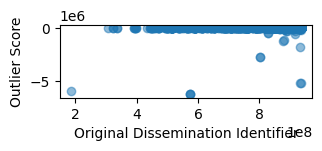

In [114]:
# prompt: I want to show this anomoly score for outlier and normal records for each feature  on grid plot, grid contais a sub plot for each feature and I want to add action type as hover, classify anomolus and normal as per threshold on socre

import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import mplcursors

# Assuming 'dff' is your DataFrame with the outlier scores and feature contribution scores.

# Select the features and their corresponding outlier scores
features = numeric_cols_actual  # List of your numeric features
scores = dff['outlier_scores']

# Define a threshold for classifying anomalies
threshold = -2  # Adjust this threshold as needed

# Create a grid plot with subplots for each feature
fig = plt.figure(figsize=(15, 10))
num_features = len(features)

cols = 4
num_rows = max(1, (len(numeric_cols_actual) + cols - 1) // cols)

print(num_rows)
print (len(numeric_cols_actual))

for i, feature in enumerate(features):
    ax = fig.add_subplot(num_rows, cols, i+1 )
    # Scatter plot for the feature
    ax.scatter(dff[feature], scores, alpha=0.5)
    ax.set_xlabel(feature)
    ax.set_ylabel('Outlier Score')

    # Add labels for anomalies and normal points
    anomalies = dff[dff['outlier_scores'] <= threshold]
    normal = dff[dff['outlier_scores'] > threshold]
    ax.scatter(anomalies[feature], anomalies['outlier_scores'], color='red', label='A')
    ax.scatter(normal[feature], normal['outlier_scores'], color='green', label='N')

    ax.legend()

plt.tight_layout()
plt.show()


In [116]:
!pip install mplcursors


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.8/88.8 kB 3.6 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.3/8.3 MB 54.6 MB/s eta 0:00:00
  Created wheel for mplcursors: filename=mplcursors-0.5.3-py3-none-any.whl size=20727 sha256=6387ccb2e34ed60e4525868a50b992307b8570193511a6ae0b0597621cd5be12
  Stored in directory: /root/.cache/pip/wheels/83/43/92/44f9515471f56877c774a515a2902d3e5484ea1bc7fd412d03
Successfully built mplcursors
  Attempting uninstall: matplotlib
    Found existing installation: matplotlib 3.7.1
    Uninstalling matplotlib-3.7.1:
      Successfully uninstalled matplotlib-3.7.1


NameError: name 'sel' is not defined

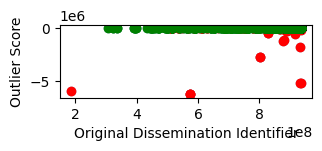

In [119]:
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import mplcursors

# Assuming 'dff' is your DataFrame with the outlier scores and feature contribution scores.

# Select the features and their corresponding outlier scores
features = numeric_cols_actual  # List of your numeric features
scores = dff['outlier_scores']

# Define a threshold for classifying anomalies
threshold = -2  # Adjust this threshold as needed

# Create a grid plot with subplots for each feature
fig = plt.figure(figsize=(15, 10))
num_features = len(features)
cursor = mplcursors.cursor(fig, hover=True)
@cursor.connect("add")
def on_add(sel):
    global dff, features
    x, y = sel.target
    index = sel.target.index
    action_type = dff.loc[index, 'action_type']
    sel.annotation.set_text(f"Action Type: {action_type}")
cols = 4
# Calculate the number of rows required, ensuring it's at least 1
num_rows = max(1, (len(numeric_cols_actual) + cols - 1) // cols)

for i, feature in enumerate(features):
    # Use i + 1 for subplot indexing (starts from 1)
    ax = fig.add_subplot(num_rows, cols, i + 1)

    # Scatter plot for the feature
    ax.scatter(dff[feature], scores, alpha=0.5)
    ax.set_xlabel(feature)
    ax.set_ylabel('Outlier Score')

    # Add labels for anomalies and normal points (without legend)
    anomalies = dff[dff['outlier_scores'] <= threshold]
    normal = dff[dff['outlier_scores'] > threshold]
    ax.scatter(anomalies[feature], anomalies['outlier_scores'], color='red') # No label here
    ax.scatter(normal[feature], normal['outlier_scores'], color='green') # No label here
    sel.annotation.set_text(f"Action: {action_type}\nTrade: {trade_type}\nScore: {y:.2f}")

plt.tight_layout()
# Create dummy scatter plots for the legend
ax.scatter([], [], color='red', label='Anomaly')
ax.scatter([], [], color='green', label='Normal')

# Add a single legend to the figure
fig.legend(loc='upper right')

plt.tight_layout()
plt.show()



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import mplcursors

# Assuming 'dff' is your DataFrame with the outlier scores and feature contribution scores.

# Select the features and their corresponding outlier scores
features = numeric_cols_actual  # List of your numeric features
scores = dff['outlier_scores']

# Define a threshold for classifying anomalies
threshold = -2  # Adjust this threshold as needed

# Create a grid plot with subplots for each feature
fig = plt.figure(figsize=(15, 10))
num_features = len(features)
cursor = mplcursors.cursor(fig, hover=True)

# Define the on_add function for mplcursors
@cursor.connect("add")
def on_add(sel):
    x, y = sel.target
    index = sel.target.index
    action_type = dff.loc[index, 'action_type']
    # Access trade_type from dff (assuming it exists)
    trade_type = dff.loc[index, 'trade_type']
    sel.annotation.set_text(f"Action: {action_type}\nTrade: {trade_type}\nScore: {y:.2f}")

cols = 4
# Calculate the number of rows required, ensuring it's at least 1
num_rows = max(1, (len(numeric_cols_actual) + cols - 1) // cols)

for i, feature in enumerate(features):
    # Use i + 1 for subplot indexing (starts from 1)
    ax = fig.add_subplot(num_rows, cols, i + 1)

    # Scatter plot for the feature
    ax.scatter(dff[feature], scores, alpha=0.5)
    ax.set_xlabel(feature)
    ax.set_ylabel('Outlier Score')

    # Add labels for anomalies and normal points (without legend)
    anomalies = dff[dff['outlier_scores'] <= threshold]
    normal = dff[dff['outlier_scores'] > threshold]
    ax.scatter(anomalies[feature], anomalies['outlier_scores'], color='red') # No label here
    ax.scatter(normal[feature], normal['outlier_scores'], color='green') # No label here
    cursor = mplcursors.cursor(ax, hover=True)
    cursor.connect("add", on_add)

plt.tight_layout()
# Create dummy scatter plots for the legend
ax.scatter([], [], color='red', label='Anomaly')
ax.scatter([], [], color='green', label='Normal')

# Add a single legend to the figure
fig.legend(loc='upper right')

plt.tight_layout()
plt.show()

In [ ]:
#take 201
import numpy as np
import matplotlib.pyplot as plt
import mplcursors

# Assuming 'dff' is your DataFrame with the outlier scores and feature contribution scores.

# Select the features and their corresponding outlier scores
features = numeric_cols_actual  # List of your numeric features
scores = dff['outlier_scores']

# Define a threshold for classifying anomalies
threshold = -2  # Adjust this threshold as needed

# Create a grid plot with subplots for each feature
fig = plt.figure(figsize=(15, 10))
num_features = len(features)

# Define the on_add function for mplcursors
def on_add(sel):
    x, y = sel.target
    index = sel.target.index
    action_type = dff.loc[index, 'action_type']
    # Access trade_type from dff (assuming it exists)
    trade_type = dff.loc[index, 'trade_type']
    sel.annotation.set_text(f"Action: {action_type}\nTrade: {trade_type}\nScore: {y:.2f}")

cols = 4
# Calculate the number of rows required, ensuring it's at least 1
num_rows = max(1, (len(numeric_cols_actual) + cols - 1) // cols)

for i, feature in enumerate(features):
    # Use i + 1 for subplot indexing (starts from 1)
    ax = fig.add_subplot(num_rows, cols, i + 1)

    # Scatter plot for the feature
    ax.scatter(dff[feature], scores, alpha=0.5)
    ax.set_xlabel(feature)
    ax.set_ylabel('Outlier Score')

    # Add labels for anomalies and normal points (without legend)
    anomalies = dff[dff['outlier_scores'] <= threshold]
    normal = dff[dff['outlier_scores'] > threshold]
    ax.scatter(anomalies[feature], anomalies['outlier_scores'], color='red') # No label here
    ax.scatter(normal[feature], normal['outlier_scores'], color='green') # No label here

    # Connect the cursor to the on_add function for this subplot
    cursor = mplcursors.cursor(ax, hover=True)
    cursor.connect("add", on_add)

plt.tight_layout()
# Create dummy scatter plots for the legend
ax.scatter([], [], color='red', label='Anomaly')
ax.scatter([], [], color='green', label='Normal')

# Add a single legend to the figure
fig.legend(loc='upper right')

plt.tight_layout()
plt.show()

In [123]:
import plotly.express as px

# Assuming 'dff' is your DataFrame with the outlier scores and feature contribution scores.

# Select the features and their corresponding outlier scores
features = numeric_cols_actual  # List of your numeric features
scores = dff['outlier_scores']

# Define a threshold for classifying anomalies
threshold = -2  # Adjust this threshold as needed

# Create a grid of scatter plots using Plotly Express
fig = px.scatter(dff, x=features, y=scores, facet_col_wrap=4,
                 color=dff['outlier_scores'] <= threshold,
                 color_discrete_map={False: 'green', True: 'red'},
                 hover_data=['action_type', 'trade_type'],
                 labels={'color': 'Anomaly'})

# Update layout for better appearance
fig.update_layout(
    title='Outlier Scores for Each Feature',
    xaxis_title='Feature Value',
    yaxis_title='Outlier Score',
)

# Show the plot
fig.show()

ValueError: Value of 'hover_data_0' is not the name of a column in 'data_frame'. Expected one of ['Dissemination Identifier', 'Original Dissemination Identifier', 'Action type', 'Event type', 'Event timestamp', 'Amendment indicator', 'Asset Class', 'Product name', 'Cleared', 'Mandatory clearing indicator', 'Execution Timestamp', 'Effective Date', 'Expiration Date', 'Maturity date of the underlier', 'Non-standardized term indicator', 'Platform identifier', 'Prime brokerage transaction indicator', 'Block trade election indicator', 'Large notional off-facility swap election indicator', 'Notional amount-Leg 1', 'Notional amount-Leg 2', 'Notional currency-Leg 1', 'Notional currency-Leg 2', 'Notional quantity-Leg 1', 'Notional quantity-Leg 2', 'Total notional quantity-Leg 1', 'Total notional quantity-Leg 2', 'Quantity frequency multiplier-Leg 1', 'Quantity frequency multiplier-Leg 2', 'Quantity unit of measure-Leg 1', 'Quantity unit of measure-Leg 2', 'Quantity frequency-Leg 1', 'Quantity frequency-Leg 2', 'Notional amount in effect on associated effective date-Leg 1', 'Notional amount in effect on associated effective date-Leg 2', 'Effective date of the notional amount-Leg 1', 'Effective date of the notional amount-Leg 2', 'End date of the notional amount-Leg 1', 'End date of the notional amount-Leg 2', 'Call amount', 'Call currency', 'Put amount', 'Put currency', 'Exchange rate', 'Exchange rate basis', 'First exercise date', 'Fixed rate-Leg 1', 'Fixed rate-Leg 2', 'Option Premium Amount', 'Option Premium Currency', 'Price', 'Price unit of measure', 'Spread-Leg 1', 'Spread-Leg 2', 'Spread currency-Leg 1', 'Spread currency-Leg 2', 'Strike Price', 'Strike price currency/currency pair', 'Post-priced swap indicator', 'Price currency', 'Price notation', 'Spread notation-Leg 1', 'Spread notation-Leg 2', 'Strike price notation', 'Fixed rate day count convention-leg 1', 'Fixed rate day count convention-leg 2', 'Floating rate day count convention-leg 1', 'Floating rate day count convention-leg 2', 'Floating rate reset frequency period-leg 1', 'Floating rate reset frequency period-leg 2', 'Floating rate reset frequency period multiplier-leg 1', 'Floating rate reset frequency period multiplier-leg 2', 'Other payment amount', 'Fixed rate payment frequency period-Leg 1', 'Floating rate payment frequency period-Leg 1', 'Fixed rate payment frequency period-Leg 2', 'Floating rate payment frequency period-Leg 2', 'Fixed rate payment frequency period multiplier-Leg 1', 'Floating rate payment frequency period multiplier-Leg 1', 'Fixed rate payment frequency period multiplier-Leg 2', 'Floating rate payment frequency period multiplier-Leg 2', 'Other payment type', 'Other payment currency', 'Settlement currency-Leg 1', 'Settlement currency-Leg 2', 'Settlement location', 'Collateralisation category', 'Custom basket indicator', 'Index factor', 'Underlier ID-Leg 1', 'Underlier ID-Leg 2', 'Underlier ID source-Leg 1', 'Underlying Asset Name', 'Underlying asset subtype or underlying contract subtype-Leg 1', 'Underlying asset subtype or underlying contract subtype-Leg 2', 'Embedded Option type', 'Option Type', 'Option Style', 'Package indicator', 'Package transaction price', 'Package transaction price currency', 'Package transaction price notation', 'Package transaction spread', 'Package transaction spread currency', 'Package transaction spread notation', 'Physical delivery location-Leg 1', 'Delivery Type', 'Unique Product Identifier', 'UPI FISN', 'UPI Underlier Name', 'Dissemination Identifier_dtype', 'Dissemination Identifier_d_length', 'Dissemination Identifier_d_isnull', 'Original Dissemination Identifier_dtype', 'Original Dissemination Identifier_d_length', 'Original Dissemination Identifier_d_isnull', 'Action type_dtype', 'Action type_d_length', 'Action type_d_isnull', 'Event type_dtype', 'Event type_d_length', 'Event type_d_isnull', 'Event timestamp_dtype', 'Event timestamp_d_length', 'Event timestamp_d_isnull', 'Amendment indicator_dtype', 'Amendment indicator_d_length', 'Amendment indicator_d_isnull', 'Asset Class_dtype', 'Asset Class_d_length', 'Asset Class_d_isnull', 'Product name_dtype', 'Product name_d_length', 'Product name_d_isnull', 'Cleared_dtype', 'Cleared_d_length', 'Cleared_d_isnull', 'Mandatory clearing indicator_dtype', 'Mandatory clearing indicator_d_length', 'Mandatory clearing indicator_d_isnull', 'Execution Timestamp_dtype', 'Execution Timestamp_d_length', 'Execution Timestamp_d_isnull', 'Effective Date_dtype', 'Effective Date_d_length', 'Effective Date_d_isnull', 'Expiration Date_dtype', 'Expiration Date_d_length', 'Expiration Date_d_isnull', 'Maturity date of the underlier_dtype', 'Maturity date of the underlier_d_length', 'Maturity date of the underlier_d_isnull', 'Non-standardized term indicator_dtype', 'Non-standardized term indicator_d_length', 'Non-standardized term indicator_d_isnull', 'Platform identifier_dtype', 'Platform identifier_d_length', 'Platform identifier_d_isnull', 'Prime brokerage transaction indicator_dtype', 'Prime brokerage transaction indicator_d_length', 'Prime brokerage transaction indicator_d_isnull', 'Block trade election indicator_dtype', 'Block trade election indicator_d_length', 'Block trade election indicator_d_isnull', 'Large notional off-facility swap election indicator_dtype', 'Large notional off-facility swap election indicator_d_length', 'Large notional off-facility swap election indicator_d_isnull', 'Notional amount-Leg 1_dtype', 'Notional amount-Leg 1_d_length', 'Notional amount-Leg 1_d_isnull', 'Notional amount-Leg 2_dtype', 'Notional amount-Leg 2_d_length', 'Notional amount-Leg 2_d_isnull', 'Notional currency-Leg 1_dtype', 'Notional currency-Leg 1_d_length', 'Notional currency-Leg 1_d_isnull', 'Notional currency-Leg 2_dtype', 'Notional currency-Leg 2_d_length', 'Notional currency-Leg 2_d_isnull', 'Notional quantity-Leg 1_dtype', 'Notional quantity-Leg 1_d_length', 'Notional quantity-Leg 1_d_isnull', 'Notional quantity-Leg 2_dtype', 'Notional quantity-Leg 2_d_length', 'Notional quantity-Leg 2_d_isnull', 'Total notional quantity-Leg 1_dtype', 'Total notional quantity-Leg 1_d_length', 'Total notional quantity-Leg 1_d_isnull', 'Total notional quantity-Leg 2_dtype', 'Total notional quantity-Leg 2_d_length', 'Total notional quantity-Leg 2_d_isnull', 'Quantity frequency multiplier-Leg 1_dtype', 'Quantity frequency multiplier-Leg 1_d_length', 'Quantity frequency multiplier-Leg 1_d_isnull', 'Quantity frequency multiplier-Leg 2_dtype', 'Quantity frequency multiplier-Leg 2_d_length', 'Quantity frequency multiplier-Leg 2_d_isnull', 'Quantity unit of measure-Leg 1_dtype', 'Quantity unit of measure-Leg 1_d_length', 'Quantity unit of measure-Leg 1_d_isnull', 'Quantity unit of measure-Leg 2_dtype', 'Quantity unit of measure-Leg 2_d_length', 'Quantity unit of measure-Leg 2_d_isnull', 'Quantity frequency-Leg 1_dtype', 'Quantity frequency-Leg 1_d_length', 'Quantity frequency-Leg 1_d_isnull', 'Quantity frequency-Leg 2_dtype', 'Quantity frequency-Leg 2_d_length', 'Quantity frequency-Leg 2_d_isnull', 'Notional amount in effect on associated effective date-Leg 1_dtype', 'Notional amount in effect on associated effective date-Leg 1_d_length', 'Notional amount in effect on associated effective date-Leg 1_d_isnull', 'Notional amount in effect on associated effective date-Leg 2_dtype', 'Notional amount in effect on associated effective date-Leg 2_d_length', 'Notional amount in effect on associated effective date-Leg 2_d_isnull', 'Effective date of the notional amount-Leg 1_dtype', 'Effective date of the notional amount-Leg 1_d_length', 'Effective date of the notional amount-Leg 1_d_isnull', 'Effective date of the notional amount-Leg 2_dtype', 'Effective date of the notional amount-Leg 2_d_length', 'Effective date of the notional amount-Leg 2_d_isnull', 'End date of the notional amount-Leg 1_dtype', 'End date of the notional amount-Leg 1_d_length', 'End date of the notional amount-Leg 1_d_isnull', 'End date of the notional amount-Leg 2_dtype', 'End date of the notional amount-Leg 2_d_length', 'End date of the notional amount-Leg 2_d_isnull', 'Call amount_dtype', 'Call amount_d_length', 'Call amount_d_isnull', 'Call currency_dtype', 'Call currency_d_length', 'Call currency_d_isnull', 'Put amount_dtype', 'Put amount_d_length', 'Put amount_d_isnull', 'Put currency_dtype', 'Put currency_d_length', 'Put currency_d_isnull', 'Exchange rate_dtype', 'Exchange rate_d_length', 'Exchange rate_d_isnull', 'Exchange rate basis_dtype', 'Exchange rate basis_d_length', 'Exchange rate basis_d_isnull', 'First exercise date_dtype', 'First exercise date_d_length', 'First exercise date_d_isnull', 'Fixed rate-Leg 1_dtype', 'Fixed rate-Leg 1_d_length', 'Fixed rate-Leg 1_d_isnull', 'Fixed rate-Leg 2_dtype', 'Fixed rate-Leg 2_d_length', 'Fixed rate-Leg 2_d_isnull', 'Option Premium Amount_dtype', 'Option Premium Amount_d_length', 'Option Premium Amount_d_isnull', 'Option Premium Currency_dtype', 'Option Premium Currency_d_length', 'Option Premium Currency_d_isnull', 'Price_dtype', 'Price_d_length', 'Price_d_isnull', 'Price unit of measure_dtype', 'Price unit of measure_d_length', 'Price unit of measure_d_isnull', 'Spread-Leg 1_dtype', 'Spread-Leg 1_d_length', 'Spread-Leg 1_d_isnull', 'Spread-Leg 2_dtype', 'Spread-Leg 2_d_length', 'Spread-Leg 2_d_isnull', 'Spread currency-Leg 1_dtype', 'Spread currency-Leg 1_d_length', 'Spread currency-Leg 1_d_isnull', 'Spread currency-Leg 2_dtype', 'Spread currency-Leg 2_d_length', 'Spread currency-Leg 2_d_isnull', 'Strike Price_dtype', 'Strike Price_d_length', 'Strike Price_d_isnull', 'Strike price currency/currency pair_dtype', 'Strike price currency/currency pair_d_length', 'Strike price currency/currency pair_d_isnull', 'Post-priced swap indicator_dtype', 'Post-priced swap indicator_d_length', 'Post-priced swap indicator_d_isnull', 'Price currency_dtype', 'Price currency_d_length', 'Price currency_d_isnull', 'Price notation_dtype', 'Price notation_d_length', 'Price notation_d_isnull', 'Spread notation-Leg 1_dtype', 'Spread notation-Leg 1_d_length', 'Spread notation-Leg 1_d_isnull', 'Spread notation-Leg 2_dtype', 'Spread notation-Leg 2_d_length', 'Spread notation-Leg 2_d_isnull', 'Strike price notation_dtype', 'Strike price notation_d_length', 'Strike price notation_d_isnull', 'Fixed rate day count convention-leg 1_dtype', 'Fixed rate day count convention-leg 1_d_length', 'Fixed rate day count convention-leg 1_d_isnull', 'Fixed rate day count convention-leg 2_dtype', 'Fixed rate day count convention-leg 2_d_length', 'Fixed rate day count convention-leg 2_d_isnull', 'Floating rate day count convention-leg 1_dtype', 'Floating rate day count convention-leg 1_d_length', 'Floating rate day count convention-leg 1_d_isnull', 'Floating rate day count convention-leg 2_dtype', 'Floating rate day count convention-leg 2_d_length', 'Floating rate day count convention-leg 2_d_isnull', 'Floating rate reset frequency period-leg 1_dtype', 'Floating rate reset frequency period-leg 1_d_length', 'Floating rate reset frequency period-leg 1_d_isnull', 'Floating rate reset frequency period-leg 2_dtype', 'Floating rate reset frequency period-leg 2_d_length', 'Floating rate reset frequency period-leg 2_d_isnull', 'Floating rate reset frequency period multiplier-leg 1_dtype', 'Floating rate reset frequency period multiplier-leg 1_d_length', 'Floating rate reset frequency period multiplier-leg 1_d_isnull', 'Floating rate reset frequency period multiplier-leg 2_dtype', 'Floating rate reset frequency period multiplier-leg 2_d_length', 'Floating rate reset frequency period multiplier-leg 2_d_isnull', 'Other payment amount_dtype', 'Other payment amount_d_length', 'Other payment amount_d_isnull', 'Fixed rate payment frequency period-Leg 1_dtype', 'Fixed rate payment frequency period-Leg 1_d_length', 'Fixed rate payment frequency period-Leg 1_d_isnull', 'Floating rate payment frequency period-Leg 1_dtype', 'Floating rate payment frequency period-Leg 1_d_length', 'Floating rate payment frequency period-Leg 1_d_isnull', 'Fixed rate payment frequency period-Leg 2_dtype', 'Fixed rate payment frequency period-Leg 2_d_length', 'Fixed rate payment frequency period-Leg 2_d_isnull', 'Floating rate payment frequency period-Leg 2_dtype', 'Floating rate payment frequency period-Leg 2_d_length', 'Floating rate payment frequency period-Leg 2_d_isnull', 'Fixed rate payment frequency period multiplier-Leg 1_dtype', 'Fixed rate payment frequency period multiplier-Leg 1_d_length', 'Fixed rate payment frequency period multiplier-Leg 1_d_isnull', 'Floating rate payment frequency period multiplier-Leg 1_dtype', 'Floating rate payment frequency period multiplier-Leg 1_d_length', 'Floating rate payment frequency period multiplier-Leg 1_d_isnull', 'Fixed rate payment frequency period multiplier-Leg 2_dtype', 'Fixed rate payment frequency period multiplier-Leg 2_d_length', 'Fixed rate payment frequency period multiplier-Leg 2_d_isnull', 'Floating rate payment frequency period multiplier-Leg 2_dtype', 'Floating rate payment frequency period multiplier-Leg 2_d_length', 'Floating rate payment frequency period multiplier-Leg 2_d_isnull', 'Other payment type_dtype', 'Other payment type_d_length', 'Other payment type_d_isnull', 'Other payment currency_dtype', 'Other payment currency_d_length', 'Other payment currency_d_isnull', 'Settlement currency-Leg 1_dtype', 'Settlement currency-Leg 1_d_length', 'Settlement currency-Leg 1_d_isnull', 'Settlement currency-Leg 2_dtype', 'Settlement currency-Leg 2_d_length', 'Settlement currency-Leg 2_d_isnull', 'Settlement location_dtype', 'Settlement location_d_length', 'Settlement location_d_isnull', 'Collateralisation category_dtype', 'Collateralisation category_d_length', 'Collateralisation category_d_isnull', 'Custom basket indicator_dtype', 'Custom basket indicator_d_length', 'Custom basket indicator_d_isnull', 'Index factor_dtype', 'Index factor_d_length', 'Index factor_d_isnull', 'Underlier ID-Leg 1_dtype', 'Underlier ID-Leg 1_d_length', 'Underlier ID-Leg 1_d_isnull', 'Underlier ID-Leg 2_dtype', 'Underlier ID-Leg 2_d_length', 'Underlier ID-Leg 2_d_isnull', 'Underlier ID source-Leg 1_dtype', 'Underlier ID source-Leg 1_d_length', 'Underlier ID source-Leg 1_d_isnull', 'Underlying Asset Name_dtype', 'Underlying Asset Name_d_length', 'Underlying Asset Name_d_isnull', 'Underlying asset subtype or underlying contract subtype-Leg 1_dtype', 'Underlying asset subtype or underlying contract subtype-Leg 1_d_length', 'Underlying asset subtype or underlying contract subtype-Leg 1_d_isnull', 'Underlying asset subtype or underlying contract subtype-Leg 2_dtype', 'Underlying asset subtype or underlying contract subtype-Leg 2_d_length', 'Underlying asset subtype or underlying contract subtype-Leg 2_d_isnull', 'Embedded Option type_dtype', 'Embedded Option type_d_length', 'Embedded Option type_d_isnull', 'Option Type_dtype', 'Option Type_d_length', 'Option Type_d_isnull', 'Option Style_dtype', 'Option Style_d_length', 'Option Style_d_isnull', 'Package indicator_dtype', 'Package indicator_d_length', 'Package indicator_d_isnull', 'Package transaction price_dtype', 'Package transaction price_d_length', 'Package transaction price_d_isnull', 'Package transaction price currency_dtype', 'Package transaction price currency_d_length', 'Package transaction price currency_d_isnull', 'Package transaction price notation_dtype', 'Package transaction price notation_d_length', 'Package transaction price notation_d_isnull', 'Package transaction spread_dtype', 'Package transaction spread_d_length', 'Package transaction spread_d_isnull', 'Package transaction spread currency_dtype', 'Package transaction spread currency_d_length', 'Package transaction spread currency_d_isnull', 'Package transaction spread notation_dtype', 'Package transaction spread notation_d_length', 'Package transaction spread notation_d_isnull', 'Physical delivery location-Leg 1_dtype', 'Physical delivery location-Leg 1_d_length', 'Physical delivery location-Leg 1_d_isnull', 'Delivery Type_dtype', 'Delivery Type_d_length', 'Delivery Type_d_isnull', 'Unique Product Identifier_dtype', 'Unique Product Identifier_d_length', 'Unique Product Identifier_d_isnull', 'UPI FISN_dtype', 'UPI FISN_d_length', 'UPI FISN_d_isnull', 'UPI Underlier Name_dtype', 'UPI Underlier Name_d_length', 'UPI Underlier Name_d_isnull', 'missing_count', 'outlier_scores', 'feature_contribution_scores', 'customdata'] but received: action_type

In [124]:
import plotly.express as px

# Assuming 'dff' is your DataFrame with the outlier scores and feature contribution scores.

# Select the features and their corresponding outlier scores
features = numeric_cols_actual  # List of your numeric features
scores = dff['outlier_scores']

# Define a threshold for classifying anomalies
threshold = -2  # Adjust this threshold as needed

# Create a grid of scatter plots using Plotly Express
# Check if 'action_type' and 'trade_type' are actual column names in dff
# If not, replace with correct column names
fig = px.scatter(dff, x=features, y=scores, facet_col_wrap=4,
                 color=dff['outlier_scores'] <= threshold,
                 color_discrete_map={False: 'green', True: 'red'},
                 hover_data=['Action type', 'trade_type'], # Verify these column names exist in dff
                 labels={'color': 'Anomaly'})

# Update layout for better appearance
fig.update_layout(
    title='Outlier Scores for Each Feature',
    xaxis_title='Feature Value',
    yaxis_title='Outlier Score',
)

# Show the plot
fig.show()

ValueError: Value of 'hover_data_1' is not the name of a column in 'data_frame'. Expected one of ['Dissemination Identifier', 'Original Dissemination Identifier', 'Action type', 'Event type', 'Event timestamp', 'Amendment indicator', 'Asset Class', 'Product name', 'Cleared', 'Mandatory clearing indicator', 'Execution Timestamp', 'Effective Date', 'Expiration Date', 'Maturity date of the underlier', 'Non-standardized term indicator', 'Platform identifier', 'Prime brokerage transaction indicator', 'Block trade election indicator', 'Large notional off-facility swap election indicator', 'Notional amount-Leg 1', 'Notional amount-Leg 2', 'Notional currency-Leg 1', 'Notional currency-Leg 2', 'Notional quantity-Leg 1', 'Notional quantity-Leg 2', 'Total notional quantity-Leg 1', 'Total notional quantity-Leg 2', 'Quantity frequency multiplier-Leg 1', 'Quantity frequency multiplier-Leg 2', 'Quantity unit of measure-Leg 1', 'Quantity unit of measure-Leg 2', 'Quantity frequency-Leg 1', 'Quantity frequency-Leg 2', 'Notional amount in effect on associated effective date-Leg 1', 'Notional amount in effect on associated effective date-Leg 2', 'Effective date of the notional amount-Leg 1', 'Effective date of the notional amount-Leg 2', 'End date of the notional amount-Leg 1', 'End date of the notional amount-Leg 2', 'Call amount', 'Call currency', 'Put amount', 'Put currency', 'Exchange rate', 'Exchange rate basis', 'First exercise date', 'Fixed rate-Leg 1', 'Fixed rate-Leg 2', 'Option Premium Amount', 'Option Premium Currency', 'Price', 'Price unit of measure', 'Spread-Leg 1', 'Spread-Leg 2', 'Spread currency-Leg 1', 'Spread currency-Leg 2', 'Strike Price', 'Strike price currency/currency pair', 'Post-priced swap indicator', 'Price currency', 'Price notation', 'Spread notation-Leg 1', 'Spread notation-Leg 2', 'Strike price notation', 'Fixed rate day count convention-leg 1', 'Fixed rate day count convention-leg 2', 'Floating rate day count convention-leg 1', 'Floating rate day count convention-leg 2', 'Floating rate reset frequency period-leg 1', 'Floating rate reset frequency period-leg 2', 'Floating rate reset frequency period multiplier-leg 1', 'Floating rate reset frequency period multiplier-leg 2', 'Other payment amount', 'Fixed rate payment frequency period-Leg 1', 'Floating rate payment frequency period-Leg 1', 'Fixed rate payment frequency period-Leg 2', 'Floating rate payment frequency period-Leg 2', 'Fixed rate payment frequency period multiplier-Leg 1', 'Floating rate payment frequency period multiplier-Leg 1', 'Fixed rate payment frequency period multiplier-Leg 2', 'Floating rate payment frequency period multiplier-Leg 2', 'Other payment type', 'Other payment currency', 'Settlement currency-Leg 1', 'Settlement currency-Leg 2', 'Settlement location', 'Collateralisation category', 'Custom basket indicator', 'Index factor', 'Underlier ID-Leg 1', 'Underlier ID-Leg 2', 'Underlier ID source-Leg 1', 'Underlying Asset Name', 'Underlying asset subtype or underlying contract subtype-Leg 1', 'Underlying asset subtype or underlying contract subtype-Leg 2', 'Embedded Option type', 'Option Type', 'Option Style', 'Package indicator', 'Package transaction price', 'Package transaction price currency', 'Package transaction price notation', 'Package transaction spread', 'Package transaction spread currency', 'Package transaction spread notation', 'Physical delivery location-Leg 1', 'Delivery Type', 'Unique Product Identifier', 'UPI FISN', 'UPI Underlier Name', 'Dissemination Identifier_dtype', 'Dissemination Identifier_d_length', 'Dissemination Identifier_d_isnull', 'Original Dissemination Identifier_dtype', 'Original Dissemination Identifier_d_length', 'Original Dissemination Identifier_d_isnull', 'Action type_dtype', 'Action type_d_length', 'Action type_d_isnull', 'Event type_dtype', 'Event type_d_length', 'Event type_d_isnull', 'Event timestamp_dtype', 'Event timestamp_d_length', 'Event timestamp_d_isnull', 'Amendment indicator_dtype', 'Amendment indicator_d_length', 'Amendment indicator_d_isnull', 'Asset Class_dtype', 'Asset Class_d_length', 'Asset Class_d_isnull', 'Product name_dtype', 'Product name_d_length', 'Product name_d_isnull', 'Cleared_dtype', 'Cleared_d_length', 'Cleared_d_isnull', 'Mandatory clearing indicator_dtype', 'Mandatory clearing indicator_d_length', 'Mandatory clearing indicator_d_isnull', 'Execution Timestamp_dtype', 'Execution Timestamp_d_length', 'Execution Timestamp_d_isnull', 'Effective Date_dtype', 'Effective Date_d_length', 'Effective Date_d_isnull', 'Expiration Date_dtype', 'Expiration Date_d_length', 'Expiration Date_d_isnull', 'Maturity date of the underlier_dtype', 'Maturity date of the underlier_d_length', 'Maturity date of the underlier_d_isnull', 'Non-standardized term indicator_dtype', 'Non-standardized term indicator_d_length', 'Non-standardized term indicator_d_isnull', 'Platform identifier_dtype', 'Platform identifier_d_length', 'Platform identifier_d_isnull', 'Prime brokerage transaction indicator_dtype', 'Prime brokerage transaction indicator_d_length', 'Prime brokerage transaction indicator_d_isnull', 'Block trade election indicator_dtype', 'Block trade election indicator_d_length', 'Block trade election indicator_d_isnull', 'Large notional off-facility swap election indicator_dtype', 'Large notional off-facility swap election indicator_d_length', 'Large notional off-facility swap election indicator_d_isnull', 'Notional amount-Leg 1_dtype', 'Notional amount-Leg 1_d_length', 'Notional amount-Leg 1_d_isnull', 'Notional amount-Leg 2_dtype', 'Notional amount-Leg 2_d_length', 'Notional amount-Leg 2_d_isnull', 'Notional currency-Leg 1_dtype', 'Notional currency-Leg 1_d_length', 'Notional currency-Leg 1_d_isnull', 'Notional currency-Leg 2_dtype', 'Notional currency-Leg 2_d_length', 'Notional currency-Leg 2_d_isnull', 'Notional quantity-Leg 1_dtype', 'Notional quantity-Leg 1_d_length', 'Notional quantity-Leg 1_d_isnull', 'Notional quantity-Leg 2_dtype', 'Notional quantity-Leg 2_d_length', 'Notional quantity-Leg 2_d_isnull', 'Total notional quantity-Leg 1_dtype', 'Total notional quantity-Leg 1_d_length', 'Total notional quantity-Leg 1_d_isnull', 'Total notional quantity-Leg 2_dtype', 'Total notional quantity-Leg 2_d_length', 'Total notional quantity-Leg 2_d_isnull', 'Quantity frequency multiplier-Leg 1_dtype', 'Quantity frequency multiplier-Leg 1_d_length', 'Quantity frequency multiplier-Leg 1_d_isnull', 'Quantity frequency multiplier-Leg 2_dtype', 'Quantity frequency multiplier-Leg 2_d_length', 'Quantity frequency multiplier-Leg 2_d_isnull', 'Quantity unit of measure-Leg 1_dtype', 'Quantity unit of measure-Leg 1_d_length', 'Quantity unit of measure-Leg 1_d_isnull', 'Quantity unit of measure-Leg 2_dtype', 'Quantity unit of measure-Leg 2_d_length', 'Quantity unit of measure-Leg 2_d_isnull', 'Quantity frequency-Leg 1_dtype', 'Quantity frequency-Leg 1_d_length', 'Quantity frequency-Leg 1_d_isnull', 'Quantity frequency-Leg 2_dtype', 'Quantity frequency-Leg 2_d_length', 'Quantity frequency-Leg 2_d_isnull', 'Notional amount in effect on associated effective date-Leg 1_dtype', 'Notional amount in effect on associated effective date-Leg 1_d_length', 'Notional amount in effect on associated effective date-Leg 1_d_isnull', 'Notional amount in effect on associated effective date-Leg 2_dtype', 'Notional amount in effect on associated effective date-Leg 2_d_length', 'Notional amount in effect on associated effective date-Leg 2_d_isnull', 'Effective date of the notional amount-Leg 1_dtype', 'Effective date of the notional amount-Leg 1_d_length', 'Effective date of the notional amount-Leg 1_d_isnull', 'Effective date of the notional amount-Leg 2_dtype', 'Effective date of the notional amount-Leg 2_d_length', 'Effective date of the notional amount-Leg 2_d_isnull', 'End date of the notional amount-Leg 1_dtype', 'End date of the notional amount-Leg 1_d_length', 'End date of the notional amount-Leg 1_d_isnull', 'End date of the notional amount-Leg 2_dtype', 'End date of the notional amount-Leg 2_d_length', 'End date of the notional amount-Leg 2_d_isnull', 'Call amount_dtype', 'Call amount_d_length', 'Call amount_d_isnull', 'Call currency_dtype', 'Call currency_d_length', 'Call currency_d_isnull', 'Put amount_dtype', 'Put amount_d_length', 'Put amount_d_isnull', 'Put currency_dtype', 'Put currency_d_length', 'Put currency_d_isnull', 'Exchange rate_dtype', 'Exchange rate_d_length', 'Exchange rate_d_isnull', 'Exchange rate basis_dtype', 'Exchange rate basis_d_length', 'Exchange rate basis_d_isnull', 'First exercise date_dtype', 'First exercise date_d_length', 'First exercise date_d_isnull', 'Fixed rate-Leg 1_dtype', 'Fixed rate-Leg 1_d_length', 'Fixed rate-Leg 1_d_isnull', 'Fixed rate-Leg 2_dtype', 'Fixed rate-Leg 2_d_length', 'Fixed rate-Leg 2_d_isnull', 'Option Premium Amount_dtype', 'Option Premium Amount_d_length', 'Option Premium Amount_d_isnull', 'Option Premium Currency_dtype', 'Option Premium Currency_d_length', 'Option Premium Currency_d_isnull', 'Price_dtype', 'Price_d_length', 'Price_d_isnull', 'Price unit of measure_dtype', 'Price unit of measure_d_length', 'Price unit of measure_d_isnull', 'Spread-Leg 1_dtype', 'Spread-Leg 1_d_length', 'Spread-Leg 1_d_isnull', 'Spread-Leg 2_dtype', 'Spread-Leg 2_d_length', 'Spread-Leg 2_d_isnull', 'Spread currency-Leg 1_dtype', 'Spread currency-Leg 1_d_length', 'Spread currency-Leg 1_d_isnull', 'Spread currency-Leg 2_dtype', 'Spread currency-Leg 2_d_length', 'Spread currency-Leg 2_d_isnull', 'Strike Price_dtype', 'Strike Price_d_length', 'Strike Price_d_isnull', 'Strike price currency/currency pair_dtype', 'Strike price currency/currency pair_d_length', 'Strike price currency/currency pair_d_isnull', 'Post-priced swap indicator_dtype', 'Post-priced swap indicator_d_length', 'Post-priced swap indicator_d_isnull', 'Price currency_dtype', 'Price currency_d_length', 'Price currency_d_isnull', 'Price notation_dtype', 'Price notation_d_length', 'Price notation_d_isnull', 'Spread notation-Leg 1_dtype', 'Spread notation-Leg 1_d_length', 'Spread notation-Leg 1_d_isnull', 'Spread notation-Leg 2_dtype', 'Spread notation-Leg 2_d_length', 'Spread notation-Leg 2_d_isnull', 'Strike price notation_dtype', 'Strike price notation_d_length', 'Strike price notation_d_isnull', 'Fixed rate day count convention-leg 1_dtype', 'Fixed rate day count convention-leg 1_d_length', 'Fixed rate day count convention-leg 1_d_isnull', 'Fixed rate day count convention-leg 2_dtype', 'Fixed rate day count convention-leg 2_d_length', 'Fixed rate day count convention-leg 2_d_isnull', 'Floating rate day count convention-leg 1_dtype', 'Floating rate day count convention-leg 1_d_length', 'Floating rate day count convention-leg 1_d_isnull', 'Floating rate day count convention-leg 2_dtype', 'Floating rate day count convention-leg 2_d_length', 'Floating rate day count convention-leg 2_d_isnull', 'Floating rate reset frequency period-leg 1_dtype', 'Floating rate reset frequency period-leg 1_d_length', 'Floating rate reset frequency period-leg 1_d_isnull', 'Floating rate reset frequency period-leg 2_dtype', 'Floating rate reset frequency period-leg 2_d_length', 'Floating rate reset frequency period-leg 2_d_isnull', 'Floating rate reset frequency period multiplier-leg 1_dtype', 'Floating rate reset frequency period multiplier-leg 1_d_length', 'Floating rate reset frequency period multiplier-leg 1_d_isnull', 'Floating rate reset frequency period multiplier-leg 2_dtype', 'Floating rate reset frequency period multiplier-leg 2_d_length', 'Floating rate reset frequency period multiplier-leg 2_d_isnull', 'Other payment amount_dtype', 'Other payment amount_d_length', 'Other payment amount_d_isnull', 'Fixed rate payment frequency period-Leg 1_dtype', 'Fixed rate payment frequency period-Leg 1_d_length', 'Fixed rate payment frequency period-Leg 1_d_isnull', 'Floating rate payment frequency period-Leg 1_dtype', 'Floating rate payment frequency period-Leg 1_d_length', 'Floating rate payment frequency period-Leg 1_d_isnull', 'Fixed rate payment frequency period-Leg 2_dtype', 'Fixed rate payment frequency period-Leg 2_d_length', 'Fixed rate payment frequency period-Leg 2_d_isnull', 'Floating rate payment frequency period-Leg 2_dtype', 'Floating rate payment frequency period-Leg 2_d_length', 'Floating rate payment frequency period-Leg 2_d_isnull', 'Fixed rate payment frequency period multiplier-Leg 1_dtype', 'Fixed rate payment frequency period multiplier-Leg 1_d_length', 'Fixed rate payment frequency period multiplier-Leg 1_d_isnull', 'Floating rate payment frequency period multiplier-Leg 1_dtype', 'Floating rate payment frequency period multiplier-Leg 1_d_length', 'Floating rate payment frequency period multiplier-Leg 1_d_isnull', 'Fixed rate payment frequency period multiplier-Leg 2_dtype', 'Fixed rate payment frequency period multiplier-Leg 2_d_length', 'Fixed rate payment frequency period multiplier-Leg 2_d_isnull', 'Floating rate payment frequency period multiplier-Leg 2_dtype', 'Floating rate payment frequency period multiplier-Leg 2_d_length', 'Floating rate payment frequency period multiplier-Leg 2_d_isnull', 'Other payment type_dtype', 'Other payment type_d_length', 'Other payment type_d_isnull', 'Other payment currency_dtype', 'Other payment currency_d_length', 'Other payment currency_d_isnull', 'Settlement currency-Leg 1_dtype', 'Settlement currency-Leg 1_d_length', 'Settlement currency-Leg 1_d_isnull', 'Settlement currency-Leg 2_dtype', 'Settlement currency-Leg 2_d_length', 'Settlement currency-Leg 2_d_isnull', 'Settlement location_dtype', 'Settlement location_d_length', 'Settlement location_d_isnull', 'Collateralisation category_dtype', 'Collateralisation category_d_length', 'Collateralisation category_d_isnull', 'Custom basket indicator_dtype', 'Custom basket indicator_d_length', 'Custom basket indicator_d_isnull', 'Index factor_dtype', 'Index factor_d_length', 'Index factor_d_isnull', 'Underlier ID-Leg 1_dtype', 'Underlier ID-Leg 1_d_length', 'Underlier ID-Leg 1_d_isnull', 'Underlier ID-Leg 2_dtype', 'Underlier ID-Leg 2_d_length', 'Underlier ID-Leg 2_d_isnull', 'Underlier ID source-Leg 1_dtype', 'Underlier ID source-Leg 1_d_length', 'Underlier ID source-Leg 1_d_isnull', 'Underlying Asset Name_dtype', 'Underlying Asset Name_d_length', 'Underlying Asset Name_d_isnull', 'Underlying asset subtype or underlying contract subtype-Leg 1_dtype', 'Underlying asset subtype or underlying contract subtype-Leg 1_d_length', 'Underlying asset subtype or underlying contract subtype-Leg 1_d_isnull', 'Underlying asset subtype or underlying contract subtype-Leg 2_dtype', 'Underlying asset subtype or underlying contract subtype-Leg 2_d_length', 'Underlying asset subtype or underlying contract subtype-Leg 2_d_isnull', 'Embedded Option type_dtype', 'Embedded Option type_d_length', 'Embedded Option type_d_isnull', 'Option Type_dtype', 'Option Type_d_length', 'Option Type_d_isnull', 'Option Style_dtype', 'Option Style_d_length', 'Option Style_d_isnull', 'Package indicator_dtype', 'Package indicator_d_length', 'Package indicator_d_isnull', 'Package transaction price_dtype', 'Package transaction price_d_length', 'Package transaction price_d_isnull', 'Package transaction price currency_dtype', 'Package transaction price currency_d_length', 'Package transaction price currency_d_isnull', 'Package transaction price notation_dtype', 'Package transaction price notation_d_length', 'Package transaction price notation_d_isnull', 'Package transaction spread_dtype', 'Package transaction spread_d_length', 'Package transaction spread_d_isnull', 'Package transaction spread currency_dtype', 'Package transaction spread currency_d_length', 'Package transaction spread currency_d_isnull', 'Package transaction spread notation_dtype', 'Package transaction spread notation_d_length', 'Package transaction spread notation_d_isnull', 'Physical delivery location-Leg 1_dtype', 'Physical delivery location-Leg 1_d_length', 'Physical delivery location-Leg 1_d_isnull', 'Delivery Type_dtype', 'Delivery Type_d_length', 'Delivery Type_d_isnull', 'Unique Product Identifier_dtype', 'Unique Product Identifier_d_length', 'Unique Product Identifier_d_isnull', 'UPI FISN_dtype', 'UPI FISN_d_length', 'UPI FISN_d_isnull', 'UPI Underlier Name_dtype', 'UPI Underlier Name_d_length', 'UPI Underlier Name_d_isnull', 'missing_count', 'outlier_scores', 'feature_contribution_scores', 'customdata'] but received: trade_type

In [ ]:
import plotly.express as px

# Assuming 'dff' is your DataFrame with the outlier scores and feature contribution scores.

# Select the features and their corresponding outlier scores
features = numeric_cols_actual  # List of your numeric features
scores = dff['outlier_scores']

# Define a threshold for classifying anomalies
threshold = -2  # Adjust this threshold as needed

# Create a grid of scatter plots using Plotly Express
# Check if 'action_type' and 'trade_type' are actual column names in dff
# If not, replace with correct column names
fig = px.scatter(dff, x=features, y=scores, facet_col_wrap=4,
                 color=dff['outlier_scores'] <= threshold,
                 color_discrete_map={False: 'green', True: 'red'},
                 hover_data=['Action type', 'Event type'], # Verify these column names exist in dff
                 labels={'color': 'Anomaly'})

# Update layout for better appearance
fig.update_layout(
    title='Outlier Scores for Each Feature',
    xaxis_title='Feature Value',
    yaxis_title='Outlier Score',
)

# Show the plot
fig.show()

In [129]:
!pip install plotly
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Assuming 'dff' is your DataFrame with the outlier scores and feature contribution scores.

# Select the features and their corresponding outlier scores
features = numeric_cols_actual  # List of your numeric features
scores = dff['outlier_scores']

# Define a threshold for classifying anomalies
threshold = -2  # Adjust this threshold as needed

# Calculate the number of rows needed for the subplot grid
num_rows = max(1, (len(numeric_cols_actual) + cols - 1) // cols)
n_cols = 4

# Create a subplot grid
fig = make_subplots(rows=n_rows, cols=n_cols)

# Iterate through features and create scatter plots
for i, feature in enumerate(features):
    for j in range(n_cols):
        # Create scatter plot for each feature
        scatter = go.Scatter(
            x=dff[feature],
            y=scores,
            mode='markers',
            marker=dict(
                color=dff['outlier_scores'].apply(lambda x: 'red' if x <= threshold else 'green')
            ),
            hovertemplate=f"Action: {dff['Action type']}<br>Trade: {dff['Event type']}<br>Score: %{{y:.2f}}",
            name=feature
        )

        # Add scatter plot to the subplot grid
        fig.add_trace(scatter, row=i+1, col=j+1)

        # Update axes labels for each subplot
        fig.update_xaxes(title_text=feature, row=i+1, col=j+1)
        fig.update_yaxes(title_text='Outlier Score', row=i+1, col=j+1)

# Update layout for better appearance
fig.update_layout(
    title='Outlier Scores for Each Feature',
    showlegend=False, # Hide legend as it would be repetitive for each subplot
)

# Show the plot
fig.show()

In [ ]:
# prompt: int  the currnet out put 1- I want grid of sib plots at least 4 features in a row  to shorten the scrool 2- I want scatter of normal and anmolous values

from google.colab import drive
import pandas as pd
import warnings
from sklearn.ensemble import IsolationForest
from sklearn.neighbors import LocalOutlierFactor
from sklearn.preprocessing import MinMaxScaler
import numpy as np
from sklearn.model_selection import GridSearchCV
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots

drive.mount('/content/drive')
warnings.filterwarnings('ignore')
dff = pd.read_csv('/content/drive/My Drive/Colab Notebooks/anomaly/Pm_CFTC_2017649.csv')
col_cat=pd.read_csv("/content/drive/My Drive/Colab Notebooks/anomaly/col_cat_5.csv")
dff = dff[~dff.applymap(lambda x: ';' in str(x)).any(axis=1)]
dff.reset_index(drop=True, inplace=True)
dff = dff.applymap(lambda x: str(x).replace(',', '') if isinstance(x, str) else x)
dff = dff.applymap(lambda x: str(x).replace('+', '') if isinstance(x, str) else x)
dff = dff[~dff.applymap(lambda x: ';' in str(x)).any(axis=1)]

for column in dff.columns:
    dff[column + '_dtype'] = dff[column].dtypes
    dff[column + '_d_length'] = dff[column].apply(lambda x: len(str(x)))
    dff[column + '_d_isnull'] = dff[column].isnull()




dff



# Separate data based on data type
date_cols = [col for col in dff.columns if '_dtype' in col and str(dff[col].iloc[0]) == 'object']
id_cols = [col for col in dff.columns if '_dtype' in col and str(dff[col].iloc[0]) == 'object']  # Assuming IDs are also objects
numeric_cols = [col for col in dff.columns if '_dtype' in col and str(dff[col].iloc[0]) == 'float64']
numeric_cols_actual = [col.replace('_dtype', '') for col in numeric_cols]
dff['missing_count'] = dff.isnull().sum(axis=1)

# Select only the numeric columns
numeric_df = dff[numeric_cols_actual]


# Scale the data
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(numeric_df)
scaled_data = np.nan_to_num(scaled_data, nan=np.nanmean(scaled_data))


# Define the parameter grid
param_grid = {
    'n_neighbors': [10, 20, 30, 40, 50],  # Try different values for n_neighbors
    'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],  # Explore different algorithms
    'leaf_size': [20, 30, 40],  # Adjust leaf size for different algorithms
    'metric': ['euclidean', 'manhattan', 'cosine']  # Experiment with different distance metrics
}

# Create the LOF model
lof = LocalOutlierFactor()

# Create GridSearchCV object
grid_search = GridSearchCV(estimator=lof, param_grid=param_grid, cv=5, scoring='neg_mean_squared_error')

# Fit the grid search to the data
grid_search.fit(scaled_data)

# Get the best parameters
best_params = grid_search.best_params_
print("Best parameters:", best_params)

#Best parameters: {'algorithm': 'auto', 'leaf_size': 20, 'metric': 'euclidean', 'n_neighbors': 10}

#
# Apply LOF
lof = LocalOutlierFactor(n_neighbors=10, algorithm='auto', leaf_size=20, metric='euclidean')

# Fit the model to the scaled data
lof.fit(scaled_data)

# Get outlier scores
outlier_scores = lof.negative_outlier_factor_

# Create a DataFrame to store the results
results_df = pd.DataFrame({'outlier_scores': outlier_scores})

# Add column names to the results DataFrame
results_df.index = numeric_df.index

# Calculate feature contribution scores
feature_contribution_scores = lof.fit(scaled_data).negative_outlier_factor_
feature_contribution_scores = pd.DataFrame(feature_contribution_scores, columns=['contribution_score'])
feature_contribution_scores.index = numeric_df.index

results_df['feature_contribution_scores'] =  feature_contribution_scores

# Combine the results with the original data
dff = dff.join(results_df)

# Analyze the feature contribution scores
# You can further analyze the feature_contribution_scores to identify the most influential features.
# For example, you could calculate the correlation between each feature and the contribution score.
# Or, you could use a more sophisticated method like SHAP values to explain the model's predictions.

# Example: Calculate correlation between features and contribution score
correlation_df = numeric_df.join(feature_contribution_scores).corr()['contribution_score']
print(correlation_df)

# Note: This is a basic approach to feature contribution scoring.
# For more sophisticated analysis, consider using SHAP values or other model interpretability techniques.



# Assuming 'dff' contains the data with 'outlier_scores' and 'feature_contribution_scores'

# Get the numeric columns
numeric_cols_actual = [col for col in dff.columns if '_dtype' in col and str(dff[col].iloc[0]) == 'float64']
numeric_cols_actual = [col.replace('_dtype', '') for col in numeric_cols_actual]

# Calculate the number of rows and columns for the subplot grid
num_cols = 4  # Number of columns in the grid
num_rows = (len(numeric_cols_actual) + num_cols - 1) // num_cols  # Calculate the number of rows

# Create subplots
fig = make_subplots(rows=num_rows, cols=num_cols, subplot_titles=numeric_cols_actual)

# Iterate over each feature
for i, feature in enumerate(numeric_cols_actual):
    row = (i // num_cols) + 1
    col = (i % num_cols) + 1
    # Create scatter plot for the feature
    trace = go.Scatter(
        x=dff[feature],
        y=dff['outlier_scores'],
        mode='markers',
        name=feature,
        hovertemplate='<b>Feature:</b> %{x}<br>' +
                      '<b>Anomaly Score:</b> %{y}<br>' +
                      '<b>Action Type:</b> %{customdata}',
        customdata=dff['Action type']  # Replace 'action_type' with your actual action type column
    )
    # Add the trace to the subplot
    fig.add_trace(trace, row=row, col=col)

# Set layout
fig.update_layout(
    height=num_rows * 300,  # Adjust height as needed
    width=num_cols * 300,  # Adjust width as needed
    title="Anomaly Scores for Each Feature",
    showlegend=False
)

# Show the plot
fig.show()

# Scatter plot for normal and anomalous values
normal_data = dff[dff['outlier_scores'] > -1.5]  # Adjust threshold as needed
anomalous_data = dff[dff['outlier_scores'] <= -1.5]  # Adjust threshold as needed

fig = go.Figure()

# Add normal data
fig.add_trace(go.Scatter(
    x=normal_data['Feature1'],  # Replace 'Feature1' with your desired feature
    y=normal_data['Feature2'],  # Replace 'Feature2' with your desired feature
    mode='markers',
    name='Normal',
    marker=dict(color='blue')
))

# Add anomalous data
fig.add_trace(go.Scatter(
    x=anomalous_data['Feature1'],  # Replace 'Feature1' with your desired feature
    y=anomalous_data['Feature2'],  # Replace 'Feature2' with your desired feature
    mode='markers',
    name='Anomalous',
    marker=dict(color='red')
))

fig.update_layout(
    title='Normal vs Anomalous Values',
    xaxis_title='Feature 1',  # Replace with your actual feature name
    yaxis_title='Feature 2'  # Replace with your actual feature name
)

fig.show()


In [ ]:
# prompt: I want to plot distribution grid  plots for each feature for outliers and normal records,grid should be 6 features in a row and adjusrt the text size os it doesnot overlap,  just consider outlier score   for each feature

import matplotlib.pyplot as plt
import seaborn as sns

# Select the features for plotting
features = numeric_cols_actual

# Define the number of features per row
features_per_row = 6

# Calculate the number of rows needed
num_rows = (len(features) + features_per_row - 1) // features_per_row

# Create a figure and subplots
fig, axes = plt.subplots(num_rows, features_per_row, figsize=(20, 4 * num_rows))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Iterate over the features
for i, feature in enumerate(features):
    # Select the current subplot
    ax = axes[i]

    # Plot the distribution for outliers
    sns.histplot(dff[dff['outlier_scores'] < -2][feature], kde=True, ax=ax, color='red', label='Outliers')

    # Plot the distribution for normal records
    sns.histplot(dff[dff['outlier_scores'] >= -2][feature], kde=True, ax=ax, color='green', label='Normal')

    # Set the title and labels
    ax.set_title(feature, fontsize=10)  # Adjust fontsize as needed
    ax.set_xlabel('')
    ax.set_ylabel('')

    # Adjust text size for better readability
    ax.tick_params(axis='x', labelsize=8)  # Adjust fontsize as needed
    ax.tick_params(axis='y', labelsize=8)  # Adjust fontsize as needed

    # Add legend
    ax.legend(fontsize=8)  # Adjust fontsize as needed

# Remove any empty subplots
for i in range(len(features), len(axes)):
    fig.delaxes(axes[i])

# Adjust layout and display the plot
plt.tight_layout()
plt.show()


In [ ]:
#   teke 100 prompt: no I am saying we plotted hist plots in above graphs ,  please convert hist to scatter plots, add hover text as action type

import matplotlib.pyplot as plt
# Select the features for plotting
features = numeric_cols_actual

# Define the number of features per row
features_per_row = 6

# Calculate the number of rows needed
num_rows = (len(features) + features_per_row - 1) // features_per_row

# Create a figure and subplots
fig, axes = plt.subplots(num_rows, features_per_row, figsize=(20, 4 * num_rows))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Iterate over the features
for i, feature in enumerate(features):
    # Select the current subplot
    ax = axes[i]

    # Scatter plot for outliers
    outlier_data = dff[dff['outlier_scores'] < -2]
    ax.scatter(outlier_data.index, outlier_data[feature], color='red', label='Outliers', alpha=0.5)

    # Scatter plot for normal records
    normal_data = dff[dff['outlier_scores'] >= -2]
    ax.scatter(normal_data.index, normal_data[feature], color='green', label='Normal', alpha=0.5)

    # Set the title and labels
    ax.set_title(feature, fontsize=10)  # Adjust fontsize as needed
    ax.set_xlabel('Index')
    ax.set_ylabel(feature)

    # Adjust text size for better readability
    ax.tick_params(axis='x', labelsize=8)  # Adjust fontsize as needed
    ax.tick_params(axis='y', labelsize=8)  # Adjust fontsize as needed

    # Add legend
    ax.legend(fontsize=8)  # Adjust fontsize as needed

# Remove any empty subplots
for i in range(len(features), len(axes)):
    fig.delaxes(axes[i])

# Adjust layout and display the plot
plt.tight_layout()
plt.show()


ValueError: Value of 'hover_data_0' is not the name of a column in 'data_frame'. Expected one of ['Dissemination Identifier', 'Original Dissemination Identifier', 'Action type', 'Event type', 'Event timestamp', 'Amendment indicator', 'Asset Class', 'Product name', 'Cleared', 'Mandatory clearing indicator', 'Execution Timestamp', 'Effective Date', 'Expiration Date', 'Maturity date of the underlier', 'Non-standardized term indicator', 'Platform identifier', 'Prime brokerage transaction indicator', 'Block trade election indicator', 'Large notional off-facility swap election indicator', 'Notional amount-Leg 1', 'Notional amount-Leg 2', 'Notional currency-Leg 1', 'Notional currency-Leg 2', 'Notional quantity-Leg 1', 'Notional quantity-Leg 2', 'Total notional quantity-Leg 1', 'Total notional quantity-Leg 2', 'Quantity frequency multiplier-Leg 1', 'Quantity frequency multiplier-Leg 2', 'Quantity unit of measure-Leg 1', 'Quantity unit of measure-Leg 2', 'Quantity frequency-Leg 1', 'Quantity frequency-Leg 2', 'Notional amount in effect on associated effective date-Leg 1', 'Notional amount in effect on associated effective date-Leg 2', 'Effective date of the notional amount-Leg 1', 'Effective date of the notional amount-Leg 2', 'End date of the notional amount-Leg 1', 'End date of the notional amount-Leg 2', 'Call amount', 'Call currency', 'Put amount', 'Put currency', 'Exchange rate', 'Exchange rate basis', 'First exercise date', 'Fixed rate-Leg 1', 'Fixed rate-Leg 2', 'Option Premium Amount', 'Option Premium Currency', 'Price', 'Price unit of measure', 'Spread-Leg 1', 'Spread-Leg 2', 'Spread currency-Leg 1', 'Spread currency-Leg 2', 'Strike Price', 'Strike price currency/currency pair', 'Post-priced swap indicator', 'Price currency', 'Price notation', 'Spread notation-Leg 1', 'Spread notation-Leg 2', 'Strike price notation', 'Fixed rate day count convention-leg 1', 'Fixed rate day count convention-leg 2', 'Floating rate day count convention-leg 1', 'Floating rate day count convention-leg 2', 'Floating rate reset frequency period-leg 1', 'Floating rate reset frequency period-leg 2', 'Floating rate reset frequency period multiplier-leg 1', 'Floating rate reset frequency period multiplier-leg 2', 'Other payment amount', 'Fixed rate payment frequency period-Leg 1', 'Floating rate payment frequency period-Leg 1', 'Fixed rate payment frequency period-Leg 2', 'Floating rate payment frequency period-Leg 2', 'Fixed rate payment frequency period multiplier-Leg 1', 'Floating rate payment frequency period multiplier-Leg 1', 'Fixed rate payment frequency period multiplier-Leg 2', 'Floating rate payment frequency period multiplier-Leg 2', 'Other payment type', 'Other payment currency', 'Settlement currency-Leg 1', 'Settlement currency-Leg 2', 'Settlement location', 'Collateralisation category', 'Custom basket indicator', 'Index factor', 'Underlier ID-Leg 1', 'Underlier ID-Leg 2', 'Underlier ID source-Leg 1', 'Underlying Asset Name', 'Underlying asset subtype or underlying contract subtype-Leg 1', 'Underlying asset subtype or underlying contract subtype-Leg 2', 'Embedded Option type', 'Option Type', 'Option Style', 'Package indicator', 'Package transaction price', 'Package transaction price currency', 'Package transaction price notation', 'Package transaction spread', 'Package transaction spread currency', 'Package transaction spread notation', 'Physical delivery location-Leg 1', 'Delivery Type', 'Unique Product Identifier', 'UPI FISN', 'UPI Underlier Name', 'Dissemination Identifier_dtype', 'Dissemination Identifier_d_length', 'Dissemination Identifier_d_isnull', 'Original Dissemination Identifier_dtype', 'Original Dissemination Identifier_d_length', 'Original Dissemination Identifier_d_isnull', 'Action type_dtype', 'Action type_d_length', 'Action type_d_isnull', 'Event type_dtype', 'Event type_d_length', 'Event type_d_isnull', 'Event timestamp_dtype', 'Event timestamp_d_length', 'Event timestamp_d_isnull', 'Amendment indicator_dtype', 'Amendment indicator_d_length', 'Amendment indicator_d_isnull', 'Asset Class_dtype', 'Asset Class_d_length', 'Asset Class_d_isnull', 'Product name_dtype', 'Product name_d_length', 'Product name_d_isnull', 'Cleared_dtype', 'Cleared_d_length', 'Cleared_d_isnull', 'Mandatory clearing indicator_dtype', 'Mandatory clearing indicator_d_length', 'Mandatory clearing indicator_d_isnull', 'Execution Timestamp_dtype', 'Execution Timestamp_d_length', 'Execution Timestamp_d_isnull', 'Effective Date_dtype', 'Effective Date_d_length', 'Effective Date_d_isnull', 'Expiration Date_dtype', 'Expiration Date_d_length', 'Expiration Date_d_isnull', 'Maturity date of the underlier_dtype', 'Maturity date of the underlier_d_length', 'Maturity date of the underlier_d_isnull', 'Non-standardized term indicator_dtype', 'Non-standardized term indicator_d_length', 'Non-standardized term indicator_d_isnull', 'Platform identifier_dtype', 'Platform identifier_d_length', 'Platform identifier_d_isnull', 'Prime brokerage transaction indicator_dtype', 'Prime brokerage transaction indicator_d_length', 'Prime brokerage transaction indicator_d_isnull', 'Block trade election indicator_dtype', 'Block trade election indicator_d_length', 'Block trade election indicator_d_isnull', 'Large notional off-facility swap election indicator_dtype', 'Large notional off-facility swap election indicator_d_length', 'Large notional off-facility swap election indicator_d_isnull', 'Notional amount-Leg 1_dtype', 'Notional amount-Leg 1_d_length', 'Notional amount-Leg 1_d_isnull', 'Notional amount-Leg 2_dtype', 'Notional amount-Leg 2_d_length', 'Notional amount-Leg 2_d_isnull', 'Notional currency-Leg 1_dtype', 'Notional currency-Leg 1_d_length', 'Notional currency-Leg 1_d_isnull', 'Notional currency-Leg 2_dtype', 'Notional currency-Leg 2_d_length', 'Notional currency-Leg 2_d_isnull', 'Notional quantity-Leg 1_dtype', 'Notional quantity-Leg 1_d_length', 'Notional quantity-Leg 1_d_isnull', 'Notional quantity-Leg 2_dtype', 'Notional quantity-Leg 2_d_length', 'Notional quantity-Leg 2_d_isnull', 'Total notional quantity-Leg 1_dtype', 'Total notional quantity-Leg 1_d_length', 'Total notional quantity-Leg 1_d_isnull', 'Total notional quantity-Leg 2_dtype', 'Total notional quantity-Leg 2_d_length', 'Total notional quantity-Leg 2_d_isnull', 'Quantity frequency multiplier-Leg 1_dtype', 'Quantity frequency multiplier-Leg 1_d_length', 'Quantity frequency multiplier-Leg 1_d_isnull', 'Quantity frequency multiplier-Leg 2_dtype', 'Quantity frequency multiplier-Leg 2_d_length', 'Quantity frequency multiplier-Leg 2_d_isnull', 'Quantity unit of measure-Leg 1_dtype', 'Quantity unit of measure-Leg 1_d_length', 'Quantity unit of measure-Leg 1_d_isnull', 'Quantity unit of measure-Leg 2_dtype', 'Quantity unit of measure-Leg 2_d_length', 'Quantity unit of measure-Leg 2_d_isnull', 'Quantity frequency-Leg 1_dtype', 'Quantity frequency-Leg 1_d_length', 'Quantity frequency-Leg 1_d_isnull', 'Quantity frequency-Leg 2_dtype', 'Quantity frequency-Leg 2_d_length', 'Quantity frequency-Leg 2_d_isnull', 'Notional amount in effect on associated effective date-Leg 1_dtype', 'Notional amount in effect on associated effective date-Leg 1_d_length', 'Notional amount in effect on associated effective date-Leg 1_d_isnull', 'Notional amount in effect on associated effective date-Leg 2_dtype', 'Notional amount in effect on associated effective date-Leg 2_d_length', 'Notional amount in effect on associated effective date-Leg 2_d_isnull', 'Effective date of the notional amount-Leg 1_dtype', 'Effective date of the notional amount-Leg 1_d_length', 'Effective date of the notional amount-Leg 1_d_isnull', 'Effective date of the notional amount-Leg 2_dtype', 'Effective date of the notional amount-Leg 2_d_length', 'Effective date of the notional amount-Leg 2_d_isnull', 'End date of the notional amount-Leg 1_dtype', 'End date of the notional amount-Leg 1_d_length', 'End date of the notional amount-Leg 1_d_isnull', 'End date of the notional amount-Leg 2_dtype', 'End date of the notional amount-Leg 2_d_length', 'End date of the notional amount-Leg 2_d_isnull', 'Call amount_dtype', 'Call amount_d_length', 'Call amount_d_isnull', 'Call currency_dtype', 'Call currency_d_length', 'Call currency_d_isnull', 'Put amount_dtype', 'Put amount_d_length', 'Put amount_d_isnull', 'Put currency_dtype', 'Put currency_d_length', 'Put currency_d_isnull', 'Exchange rate_dtype', 'Exchange rate_d_length', 'Exchange rate_d_isnull', 'Exchange rate basis_dtype', 'Exchange rate basis_d_length', 'Exchange rate basis_d_isnull', 'First exercise date_dtype', 'First exercise date_d_length', 'First exercise date_d_isnull', 'Fixed rate-Leg 1_dtype', 'Fixed rate-Leg 1_d_length', 'Fixed rate-Leg 1_d_isnull', 'Fixed rate-Leg 2_dtype', 'Fixed rate-Leg 2_d_length', 'Fixed rate-Leg 2_d_isnull', 'Option Premium Amount_dtype', 'Option Premium Amount_d_length', 'Option Premium Amount_d_isnull', 'Option Premium Currency_dtype', 'Option Premium Currency_d_length', 'Option Premium Currency_d_isnull', 'Price_dtype', 'Price_d_length', 'Price_d_isnull', 'Price unit of measure_dtype', 'Price unit of measure_d_length', 'Price unit of measure_d_isnull', 'Spread-Leg 1_dtype', 'Spread-Leg 1_d_length', 'Spread-Leg 1_d_isnull', 'Spread-Leg 2_dtype', 'Spread-Leg 2_d_length', 'Spread-Leg 2_d_isnull', 'Spread currency-Leg 1_dtype', 'Spread currency-Leg 1_d_length', 'Spread currency-Leg 1_d_isnull', 'Spread currency-Leg 2_dtype', 'Spread currency-Leg 2_d_length', 'Spread currency-Leg 2_d_isnull', 'Strike Price_dtype', 'Strike Price_d_length', 'Strike Price_d_isnull', 'Strike price currency/currency pair_dtype', 'Strike price currency/currency pair_d_length', 'Strike price currency/currency pair_d_isnull', 'Post-priced swap indicator_dtype', 'Post-priced swap indicator_d_length', 'Post-priced swap indicator_d_isnull', 'Price currency_dtype', 'Price currency_d_length', 'Price currency_d_isnull', 'Price notation_dtype', 'Price notation_d_length', 'Price notation_d_isnull', 'Spread notation-Leg 1_dtype', 'Spread notation-Leg 1_d_length', 'Spread notation-Leg 1_d_isnull', 'Spread notation-Leg 2_dtype', 'Spread notation-Leg 2_d_length', 'Spread notation-Leg 2_d_isnull', 'Strike price notation_dtype', 'Strike price notation_d_length', 'Strike price notation_d_isnull', 'Fixed rate day count convention-leg 1_dtype', 'Fixed rate day count convention-leg 1_d_length', 'Fixed rate day count convention-leg 1_d_isnull', 'Fixed rate day count convention-leg 2_dtype', 'Fixed rate day count convention-leg 2_d_length', 'Fixed rate day count convention-leg 2_d_isnull', 'Floating rate day count convention-leg 1_dtype', 'Floating rate day count convention-leg 1_d_length', 'Floating rate day count convention-leg 1_d_isnull', 'Floating rate day count convention-leg 2_dtype', 'Floating rate day count convention-leg 2_d_length', 'Floating rate day count convention-leg 2_d_isnull', 'Floating rate reset frequency period-leg 1_dtype', 'Floating rate reset frequency period-leg 1_d_length', 'Floating rate reset frequency period-leg 1_d_isnull', 'Floating rate reset frequency period-leg 2_dtype', 'Floating rate reset frequency period-leg 2_d_length', 'Floating rate reset frequency period-leg 2_d_isnull', 'Floating rate reset frequency period multiplier-leg 1_dtype', 'Floating rate reset frequency period multiplier-leg 1_d_length', 'Floating rate reset frequency period multiplier-leg 1_d_isnull', 'Floating rate reset frequency period multiplier-leg 2_dtype', 'Floating rate reset frequency period multiplier-leg 2_d_length', 'Floating rate reset frequency period multiplier-leg 2_d_isnull', 'Other payment amount_dtype', 'Other payment amount_d_length', 'Other payment amount_d_isnull', 'Fixed rate payment frequency period-Leg 1_dtype', 'Fixed rate payment frequency period-Leg 1_d_length', 'Fixed rate payment frequency period-Leg 1_d_isnull', 'Floating rate payment frequency period-Leg 1_dtype', 'Floating rate payment frequency period-Leg 1_d_length', 'Floating rate payment frequency period-Leg 1_d_isnull', 'Fixed rate payment frequency period-Leg 2_dtype', 'Fixed rate payment frequency period-Leg 2_d_length', 'Fixed rate payment frequency period-Leg 2_d_isnull', 'Floating rate payment frequency period-Leg 2_dtype', 'Floating rate payment frequency period-Leg 2_d_length', 'Floating rate payment frequency period-Leg 2_d_isnull', 'Fixed rate payment frequency period multiplier-Leg 1_dtype', 'Fixed rate payment frequency period multiplier-Leg 1_d_length', 'Fixed rate payment frequency period multiplier-Leg 1_d_isnull', 'Floating rate payment frequency period multiplier-Leg 1_dtype', 'Floating rate payment frequency period multiplier-Leg 1_d_length', 'Floating rate payment frequency period multiplier-Leg 1_d_isnull', 'Fixed rate payment frequency period multiplier-Leg 2_dtype', 'Fixed rate payment frequency period multiplier-Leg 2_d_length', 'Fixed rate payment frequency period multiplier-Leg 2_d_isnull', 'Floating rate payment frequency period multiplier-Leg 2_dtype', 'Floating rate payment frequency period multiplier-Leg 2_d_length', 'Floating rate payment frequency period multiplier-Leg 2_d_isnull', 'Other payment type_dtype', 'Other payment type_d_length', 'Other payment type_d_isnull', 'Other payment currency_dtype', 'Other payment currency_d_length', 'Other payment currency_d_isnull', 'Settlement currency-Leg 1_dtype', 'Settlement currency-Leg 1_d_length', 'Settlement currency-Leg 1_d_isnull', 'Settlement currency-Leg 2_dtype', 'Settlement currency-Leg 2_d_length', 'Settlement currency-Leg 2_d_isnull', 'Settlement location_dtype', 'Settlement location_d_length', 'Settlement location_d_isnull', 'Collateralisation category_dtype', 'Collateralisation category_d_length', 'Collateralisation category_d_isnull', 'Custom basket indicator_dtype', 'Custom basket indicator_d_length', 'Custom basket indicator_d_isnull', 'Index factor_dtype', 'Index factor_d_length', 'Index factor_d_isnull', 'Underlier ID-Leg 1_dtype', 'Underlier ID-Leg 1_d_length', 'Underlier ID-Leg 1_d_isnull', 'Underlier ID-Leg 2_dtype', 'Underlier ID-Leg 2_d_length', 'Underlier ID-Leg 2_d_isnull', 'Underlier ID source-Leg 1_dtype', 'Underlier ID source-Leg 1_d_length', 'Underlier ID source-Leg 1_d_isnull', 'Underlying Asset Name_dtype', 'Underlying Asset Name_d_length', 'Underlying Asset Name_d_isnull', 'Underlying asset subtype or underlying contract subtype-Leg 1_dtype', 'Underlying asset subtype or underlying contract subtype-Leg 1_d_length', 'Underlying asset subtype or underlying contract subtype-Leg 1_d_isnull', 'Underlying asset subtype or underlying contract subtype-Leg 2_dtype', 'Underlying asset subtype or underlying contract subtype-Leg 2_d_length', 'Underlying asset subtype or underlying contract subtype-Leg 2_d_isnull', 'Embedded Option type_dtype', 'Embedded Option type_d_length', 'Embedded Option type_d_isnull', 'Option Type_dtype', 'Option Type_d_length', 'Option Type_d_isnull', 'Option Style_dtype', 'Option Style_d_length', 'Option Style_d_isnull', 'Package indicator_dtype', 'Package indicator_d_length', 'Package indicator_d_isnull', 'Package transaction price_dtype', 'Package transaction price_d_length', 'Package transaction price_d_isnull', 'Package transaction price currency_dtype', 'Package transaction price currency_d_length', 'Package transaction price currency_d_isnull', 'Package transaction price notation_dtype', 'Package transaction price notation_d_length', 'Package transaction price notation_d_isnull', 'Package transaction spread_dtype', 'Package transaction spread_d_length', 'Package transaction spread_d_isnull', 'Package transaction spread currency_dtype', 'Package transaction spread currency_d_length', 'Package transaction spread currency_d_isnull', 'Package transaction spread notation_dtype', 'Package transaction spread notation_d_length', 'Package transaction spread notation_d_isnull', 'Physical delivery location-Leg 1_dtype', 'Physical delivery location-Leg 1_d_length', 'Physical delivery location-Leg 1_d_isnull', 'Delivery Type_dtype', 'Delivery Type_d_length', 'Delivery Type_d_isnull', 'Unique Product Identifier_dtype', 'Unique Product Identifier_d_length', 'Unique Product Identifier_d_isnull', 'UPI FISN_dtype', 'UPI FISN_d_length', 'UPI FISN_d_isnull', 'UPI Underlier Name_dtype', 'UPI Underlier Name_d_length', 'UPI Underlier Name_d_isnull', 'missing_count', 'outlier_scores', 'feature_contribution_scores'] but received: action_type

In [ ]:
# --- teake it 1010 prompt: add hover text as action type in the above plot

import matplotlib.pyplot as plt
# Select the features for plotting
features = numeric_cols_actual

# Define the number of features per row
features_per_row = 6

# Calculate the number of rows needed
num_rows = (len(features) + features_per_row - 1) // features_per_row

# Create a figure and subplots
fig, axes = plt.subplots(num_rows, features_per_row, figsize=(20, 4 * num_rows))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Iterate over the features
for i, feature in enumerate(features):
    # Select the current subplot
    ax = axes[i]

    # Scatter plot for outliers
    outlier_data = dff[dff['outlier_scores'] < -2]
    sc1 = ax.scatter(outlier_data.index, outlier_data[feature], color='red', label='Outliers', alpha=0.5)

    # Scatter plot for normal records
    normal_data = dff[dff['outlier_scores'] >= -2]
    sc2 = ax.scatter(normal_data.index, normal_data[feature], color='green', label='Normal', alpha=0.5)

    # Set the title and labels
    ax.set_title(feature, fontsize=10)  # Adjust fontsize as needed
    ax.set_xlabel('Index')
    ax.set_ylabel(feature)

    # Adjust text size for better readability
    ax.tick_params(axis='x', labelsize=8)  # Adjust fontsize as needed
    ax.tick_params(axis='y', labelsize=8)  # Adjust fontsize as needed

    # Add hover text
    def hover(event):
        if event.inaxes == ax:
            cont, ind = sc1.contains(event)
            if cont:
                ind = ind["ind"][0]
                data_point = outlier_data.iloc[ind]
                ax.set_title(f"Action Type: {data_point['action_type']}")  # Replace 'action_type' with the actual column name
                fig.canvas.draw_idle()
            else:
                cont, ind = sc2.contains(event)
                if cont:
                    ind = ind["ind"][0]
                    data_point = normal_data.iloc[ind]
                    ax.set_title(f"Action Type: {data_point['action_type']}")  # Replace 'action_type' with the actual column name
                    fig.canvas.draw_idle()
                else:
                    ax.set_title(feature)
                    fig.canvas.draw_idle()

    fig.canvas.mpl_connect("motion_notify_event", hover)

    # Add legend
    ax.legend(fontsize=8)  # Adjust fontsize as needed

# Remove any empty subplots
for i in range(len(features), len(axes)):
    fig.delaxes(axes[i])

# Adjust layout and display the plot
plt.tight_layout()
plt.show()


In [ ]:
numeric_df

In [ ]:
assert# prompt: I want to do a grid of interactive plot for each feature where I can show normal vs anomaly,  these plot should have drilldown functionality, I want to add hover text action type on each graph,

import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Assuming 'dff' is your DataFrame with the outlier scores and feature contribution scores

# Create a list of numeric columns
numeric_cols_actual = [col for col in dff.columns if '_dtype' in col and str(dff[col].iloc[0]) == 'float64']
numeric_cols_actual = [col.replace('_dtype', '') for col in numeric_cols_actual]

# Create a grid of interactive plots
fig = make_subplots(rows=len(numeric_cols_actual) // 3 + 1, cols=3, subplot_titles=numeric_cols_actual)

# Loop through each numeric column
for i, col in enumerate(numeric_cols_actual):
  row = i // 3 + 1
  col_idx = i % 3 + 1

  # Create a scatter plot with hover information
  trace = go.Scatter(
      x=dff.index,
      y=dff[col],
      mode='markers',
      marker=dict(
          color=dff['feature_contribution_scores'],  # Use contribution score for color
          size=8,
          colorscale='Viridis',
          showscale=False
      ),
      hovertemplate=
          '<b>Index:</b> %{x}<br>' +
          '<b>' + col +':</b> %{y}<br>' +
          '<b>Contribution Score:</b> %{marker.color}<br>' +
          '<b>Action type:</b> %{customdata[0]}<br>' +  # Assuming 'Action type' is in the first custom data column
          '<b>Event type:</b> %{customdata[1]}<br>' +   # Assuming 'Event type' is in the second custom data column
          '<b>Event timestamp:</b> %{customdata[2]}<br>'  # Assuming 'Event timestamp' is in the third custom data column
  )

  # Add custom data for hover information
  dff['customdata'] = dff[['Action type', 'Event type', 'Event timestamp']].values.tolist()  # Replace with actual column names

  # Add the trace to the subplot
  fig.add_trace(trace, row=row, col=col_idx)

# Update layout for better visualization
fig.update_layout(
    height=1000,
    width=1200,
)

# Show the plot
fig.show()


In [ ]:
# prompt: which scaling should be used to find anmomaly in category data ?

# For categorical data, you typically don't use traditional scaling methods like MinMaxScaler or StandardScaler.
# Instead, you can use techniques like one-hot encoding or target encoding.

# One-hot encoding:
# This converts each category into a binary feature.
# For example, if you have a column with categories "red", "green", and "blue",
# one-hot encoding would create three new columns: "red", "green", and "blue".
# Each row would have a 1 in the column corresponding to its category and 0 in the others.

# Example:
import pandas as pd

data = {'color': ['red', 'green', 'blue', 'red']}
df = pd.DataFrame(data)

df = pd.get_dummies(df, columns=['color'])
print(df)

# Target encoding:
# This replaces each category with the mean of the target variable for that category.
# This can be useful for anomaly detection if you have a target variable that you want to predict.

# Note: It's important to choose the appropriate encoding method based on the specific characteristics of your data and the anomaly detection algorithm you are using.


SyntaxError: invalid syntax (<ipython-input-92-e686628a7e36>, line 1)

In [ ]:
# prompt: I want to do same with hist plot grid  which show distribution of anomolus vs normal  in interactive grid, make subplot titles smaller , add 'Action type', 'Event type', 'Event timestamp' in the hover text, I could see normal and anomalous distribution

# Assuming 'dff' is your DataFrame with the outlier scores and feature contribution scores

# Create a list of numeric columns
numeric_cols_actual = [col for col in dff.columns if '_dtype' in col and str(dff[col].iloc[0]) == 'float64']
numeric_cols_actual = [col.replace('_dtype', '') for col in numeric_cols_actual]

# Create a grid of interactive plots
fig = make_subplots(rows=len(numeric_cols_actual) // 3 + 1, cols=3, subplot_titles=numeric_cols_actual)

# Loop through each numeric column
for i, col in enumerate(numeric_cols_actual):
  row = i // 3 + 1
  col_idx = i % 3 + 1

  # Create histograms for normal and anomalous data
  normal_data = dff[dff['feature_contribution_scores'] > -2][col]  # Adjust threshold as needed
  anomalous_data = dff[dff['feature_contribution_scores'] <= -2][col]  # Adjust threshold as needed

  # Create traces for normal and anomalous data
  trace_normal = go.Histogram(
      x=normal_data,
      name='Normal',
      marker_color='blue'
  )
  trace_anomalous = go.Histogram(
      x=anomalous_data,
      name='Anomalous',
      marker_color='red'
  )

  # Add the traces to the subplot
  fig.add_trace(trace_normal, row=row, col=col_idx)
  fig.add_trace(trace_anomalous, row=row, col=col_idx)

  # Add custom data for hover information
  dff['customdata'] = dff[['Action type', 'Event type', 'Event timestamp']].values.tolist()  # Replace with actual column names

  # Update layout for better visualization
  fig.update_layout(
      height=1000,
      width=1200,
      title_text="Interactive Histograms for Anomaly Detection",
      showlegend=True,
      font=dict(
          size=10  # Adjust font size for subplot titles
      )
  )

# Show the plot
fig.show()


In [ ]:
# takwe it 102 prompt: make subplot title smaller in the graph , and add  Action type,	Event type, 	Event timestamp in the hover text

# Assuming 'dff' is your DataFrame with the outlier scores and feature contribution scores

# Create a list of numeric columns
numeric_cols_actual = [col for col in dff.columns if '_dtype' in col and str(dff[col].iloc[0]) == 'float64']
numeric_cols_actual = [col.replace('_dtype', '') for col in numeric_cols_actual]

# Create a grid of interactive plots
fig = make_subplots(rows=len(numeric_cols_actual) // 3 + 1, cols=3,
                    subplot_titles=[f"<b>{col}</b>" for col in numeric_cols_actual])  # Smaller titles

# Loop through each numeric column
for i, col in enumerate(numeric_cols_actual):
  row = i // 3 + 1
  col_idx = i % 3 + 1

  # Create a scatter plot with hover information
  trace = go.Scatter(
      x=dff.index,
      y=dff[col],
      mode='markers',
      marker=dict(
          color=dff['feature_contribution_scores'],  # Use contribution score for color
          size=8,
          colorscale='Viridis',
          showscale=False
      ),
      hovertemplate=
          '<b>Index:</b> %{x}<br>' +
          '<b>' + col +':</b> %{y}<br>' +
          '<b>Contribution Score:</b> %{marker.color}<br>' +
          '<b>Action type:</b> %{customdata[0]}<br>' +
          '<b>Event type:</b> %{customdata[1]}<br>' +
          '<b>Event timestamp:</b> %{customdata[2]}<br>'
  )

  # Add custom data for hover information
  dff['customdata'] = dff[['Action type', 'Event type', 'Event timestamp']].values.tolist()

  # Add the trace to the subplot
  fig.add_trace(trace, row=row, col=col_idx)

# Update layout for better visualization
fig.update_layout(
    height=1000,
    width=1200,
    title_text="Interactive Plots for Anomaly Detection",
    showlegend=False
)

# Show the plot
fig.show()


In [ ]:
# prompt: can not see the value of Action type	Event type	Event timestamp , just seeing the  feature names

# Assuming 'dff' is your DataFrame with the outlier scores and feature contribution scores

# Create a list of numeric columns
numeric_cols_actual = [col for col in dff.columns if '_dtype' in col and str(dff[col].iloc[0]) == 'float64']
numeric_cols_actual = [col.replace('_dtype', '') for col in numeric_cols_actual]

# Create a grid of interactive plots
fig = make_subplots(rows=len(numeric_cols_actual) // 3 + 1, cols=3, subplot_titles=numeric_cols_actual)

# Loop through each numeric column
for i, col in enumerate(numeric_cols_actual):
  row = i // 3 + 1
  col_idx = i % 3 + 1

  # Create a scatter plot with hover information
  trace = go.Scatter(
      x=dff.index,
      y=dff[col],
      mode='markers',
      marker=dict(
          color=dff['feature_contribution_scores'],  # Use contribution score for color
          size=8,
          colorscale='Viridis',
          showscale=False
      ),
      hovertemplate=
          '<b>Index:</b> %{x}<br>' +
          '<b>' + col +':</b> %{y}<br>' +
          '<b>Contribution Score:</b> %{marker.color}<br>' +
          '<b>Action type:</b> %{customdata[0]}<br>' +  # Assuming 'Action type' is in the first custom data column
          '<b>Event type:</b> %{customdata[1]}<br>' +   # Assuming 'Event type' is in the second custom data column
          '<b>Event timestamp:</b> %{customdata[2]}<br>'  # Assuming 'Event timestamp' is in the third custom data column
  )

  # Add custom data for hover information
  dff['customdata'] = dff[['Action type', 'Event type', 'Event timestamp']].values.tolist()  # Replace with actual column names

  # Add the trace to the subplot
  fig.add_trace(trace, row=row, col=col_idx)

# Update layout for better visualization
fig.update_layout(
    height=1000,
    width=1200,
    title_text="Interactive Plots for Anomaly Detection",
    showlegend=False
)

# Show the plot
fig.show()


In [ ]:
# prompt: I still see the feature name , not the value on hovering text  in above graph

# Assuming 'dff' is your DataFrame with the outlier scores and feature contribution scores

# Create a list of numeric columns
numeric_cols_actual = [col for col in dff.columns if '_dtype' in col and str(dff[col].iloc[0]) == 'float64']
numeric_cols_actual = [col.replace('_dtype', '') for col in numeric_cols_actual]

# Create a grid of interactive plots
fig = make_subplots(rows=len(numeric_cols_actual) // 3 + 1, cols=3, subplot_titles=numeric_cols_actual)

# Loop through each numeric column
for i, col in enumerate(numeric_cols_actual):
  row = i // 3 + 1
  col_idx = i % 3 + 1

  # Create a scatter plot with hover information
  trace = go.Scatter(
      x=dff.index,
      y=dff[col],
      mode='markers',
      marker=dict(
          color=dff['feature_contribution_scores'],  # Use contribution score for color
          size=8,
          colorscale='Viridis',
          showscale=False
      ),
      hovertemplate=
          '<b>Index:</b> %{x}<br>' +
          '<b>' + col + ':</b> %{y:.2f}<br>' +  # Display the value with 2 decimal places
          '<b>Contribution Score:</b> %{marker.color}<br>' +
          '<b>Action type:</b> %{customdata[0]}<br>' +  # Assuming 'Action type' is in the first custom data column
          '<b>Event type:</b> %{customdata[1]}<br>' +   # Assuming 'Event type' is in the second custom data column
          '<b>Event timestamp:</b> %{customdata[2]}<br>'  # Assuming 'Event timestamp' is in the third custom data column
  )

  # Add custom data for hover information
  dff['customdata'] = dff[['Action type', 'Event type', 'Event timestamp']].values.tolist()  # Replace with actual column names

  # Add the trace to the subplot
  fig.add_trace(trace, row=row, col=col_idx)

# Update layout for better visualization
fig.update_layout(
    height=1000,
    width=1200,
    title_text="Interactive Plots for Anomaly Detection",
    showlegend=False
)

# Show the plot
fig.show()


In [ ]:
# prompt: I see  %{customdata[0] in place of hovering text

# Assuming 'dff' is your DataFrame with the outlier scores and feature contribution scores

# Create a list of numeric columns
numeric_cols_actual = [col for col in dff.columns if '_dtype' in col and str(dff[col].iloc[0]) == 'float64']
numeric_cols_actual = [col.replace('_dtype', '') for col in numeric_cols_actual]

# Create a grid of interactive plots
fig = make_subplots(rows=len(numeric_cols_actual) // 3 + 1, cols=3, subplot_titles=numeric_cols_actual)
dff['customdata'] = dff[['Action type', 'Event type', 'Event timestamp']].values.tolist()  # Replace with actual column names


# Loop through each numeric column
for i, col in enumerate(numeric_cols_actual):
  row = i // 3 + 1
  col_idx = i % 3 + 1
  customdata = dff[['Action type', 'Event type', 'Event timestamp']].values.tolist()

  # Create a scatter plot with hover information
  trace = go.Scatter(
      x=dff.index,
      y=dff[col],
      mode='markers',
      marker=dict(
          color=dff['feature_contribution_scores'],  # Use contribution score for color
          size=8,
          colorscale='Viridis',
          showscale=False
      ),
      hovertemplate=
          '<b>Index:</b> %{x}<br>' +
          '<b>' + col + ':</b> %{y:.2f}<br>' +  # Display the value with 2 decimal places
          '<b>Contribution Score:</b> %{marker.color}<br>' +
          '<b>Action type:</b> %{customdata[0]}<br>' +  # Assuming 'Action type' is in the first custom data column
          '<b>Event type:</b> %{customdata[1]}<br>' +   # Assuming 'Event type' is in the second custom data column
          '<b>Event timestamp:</b> %{customdata[2]}<br>'  # Assuming 'Event timestamp' is in the third custom data column
  )

  # Add custom data for hover information

  # Add the trace to the subplot
  fig.add_trace(trace, row=row, col=col_idx)

# Update layout for better visualization
fig.update_layout(
    height=1000,
    width=1200,
    title_text="Interactive Plots for Anomaly Detection",
    showlegend=False
)

# Show the plot
fig.show()


In [ ]:
# prompt: In the above code customdata value is not replaced

# Assuming 'dff' is your DataFrame with the outlier scores and feature contribution scores

# Create a list of numeric columns
numeric_cols_actual = [col for col in dff.columns if '_dtype' in col and str(dff[col].iloc[0]) == 'float64']
numeric_cols_actual = [col.replace('_dtype', '') for col in numeric_cols_actual]

# Create a grid of interactive plots
fig = make_subplots(rows=len(numeric_cols_actual) // 3 + 1, cols=3, subplot_titles=numeric_cols_actual)

# Loop through each numeric column
for i, col in enumerate(numeric_cols_actual):
  row = i // 3 + 1
  col_idx = i % 3 + 1

  # Create a scatter plot with hover information
  trace = go.Scatter(
      x=dff.index,
      y=dff[col],
      mode='markers',
      marker=dict(
          color=dff['feature_contribution_scores'],  # Use contribution score for color
          size=8,
          colorscale='Viridis',
          showscale=False
      ),
      hovertemplate=
          '<b>Index:</b> %{x}<br>' +
          '<b>' + col + ':</b> %{y:.2f}<br>' +  # Display the value with 2 decimal places
          '<b>Contribution Score:</b> %{marker.color}<br>' +
          '<b>Action type:</b> %{customdata[0]}<br>' +  # Assuming 'Action type' is in the first custom data column
          '<b>Event type:</b> %{customdata[1]}<br>' +   # Assuming 'Event type' is in the second custom data column
          '<b>Event timestamp:</b> %{customdata[2]}<br>'  # Assuming 'Event timestamp' is in the third custom data column
  )

  # Add custom data for hover information
  dff['customdata'] = dff[['Action type', 'Event type', 'Event timestamp']].values.tolist()  # Replace with actual column names

  # Add the trace to the subplot
  fig.add_trace(trace, row=row, col=col_idx)

# Update layout for better visualization
fig.update_layout(
    height=1000,
    width=1200,
    title_text="Interactive Plots for Anomaly Detection",
    showlegend=False
)

# Show the plot
fig.show()


In [ ]:
customdata[0][0]

In [ ]:
dff

In [ ]:
# prompt: is there any way to plot anomaly and nomal on a interactive plot for each feature and give drill down functionality, I want a grid of plots for 5 feature in a row , and when I hover on the point I want  to display the row  and I want to do this for all features  not only for high corrleation

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Function to create interactive scatter plot for a feature
def create_interactive_scatter(df, feature, outlier_col='outlier_scores'):
  """
  Creates an interactive scatter plot for a given feature with hover information.

  Args:
    df: Pandas DataFrame containing the data.
    feature: The name of the feature to plot.
    outlier_col: The name of the column containing outlier scores.

  Returns:
    A plotly graph object.
  """
  fig = px.scatter(df, x=feature, y=outlier_col,
                   hover_data=df.columns.tolist(),  # Show all columns on hover
                   color='outlier_scores',
                   title=f'{feature} vs. Outlier Scores')
  return fig

# Select the top 5 features (you can modify this to include all features)
features_to_plot = numeric_cols_actual[:5]

# Create subplots
fig = make_subplots(rows=len(features_to_plot) // 5 + 1, cols=5,
                    subplot_titles=features_to_plot)

# Add traces to subplots
for i, feature in enumerate(features_to_plot):
  row = i // 5 + 1
  col = i % 5 + 1
  trace = create_interactive_scatter(dff, feature)
  for trace_data in trace.data:
    fig.add_trace(trace_data, row=row, col=col)

# Update layout
fig.update_layout(height=1000, width=1500,
                  title_text="Interactive Anomaly Detection Plots")

# Show the plot
fig.show()


In [ ]:
# prompt: is there any way to plot anomaly and nomal on a interactive plot for each feature and give drill down functionality, I want a grid of plots for 5 feature in a row , and when I hover on the point I want  to display the row  and I want to do this for all features  not only for high corrleation

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Function to create interactive scatter plot for a feature
def create_interactive_scatter(df, feature, outlier_col='outlier_scores'):
  """
  Creates an interactive scatter plot for a given feature with hover information.

  Args:
    df: Pandas DataFrame containing the data.
    feature: The name of the feature to plot.
    outlier_col: The name of the column containing outlier scores.

  Returns:
    A plotly graph object.
  """
  # Convert Int64DType columns to a standard integer type
  for col in df.select_dtypes('Int64').columns:
    df[col] = df[col].astype('int')

  fig = px.scatter(df, x=feature, y=outlier_col,
                   hover_data=df.columns.tolist(),  # Show all columns on hover
                   color='outlier_scores',
                   title=f'{feature} vs. Outlier Scores')
  return fig

# Select the top 5 features (you can modify this to include all features)
features_to_plot = numeric_cols_actual[:5]

# Create subplots
fig = make_subplots(rows=len(features_to_plot) // 5 + 1, cols=5,
                    subplot_titles=features_to_plot)

# Add traces to subplots
for i, feature in enumerate(features_to_plot):
  row = i // 5 + 1
  col = i % 5 + 1
  trace = create_interactive_scatter(dff, feature)
  for trace_data in trace.data:
    fig.add_trace(trace_data, row=row, col=col)

# Update layout
fig.update_layout(height=1000, width=1500,
                  title_text="Interactive Anomaly Detection Plots")

# Show the plot
fig.show()

In [ ]:
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Function to create interactive scatter plot for a feature
def create_interactive_scatter(df, feature, outlier_col='outlier_scores'):
  """
  Creates an interactive scatter plot for a given feature with hover information.

  Args:
    df: Pandas DataFrame containing the data.
    feature: The name of the feature to plot.
    outlier_col: The name of the column containing outlier scores.

  Returns:
    A plotly graph object.
  """
  # Convert Int64DType

In [ ]:
# prompt: u r not getting the point , I want to see some identifier and drill down information on graph, ok but I want to see as soon as I hover

import matplotlib.pyplot as plt
# Assuming 'dff' is your DataFrame and 'numeric_cols_actual' contains the numeric feature columns

# Select a subset of features for plotting
features_to_plot = numeric_cols_actual[:4]  # Select the first 6 features

# Create a figure and subplots
fig, axes = plt.subplots(2, len(features_to_plot), figsize=(20, 8))

# Iterate over the features and create histograms
for i, feature in enumerate(features_to_plot):
  # Normal data histogram
  sns.histplot(dff[feature][dff['outlier_scores'] > -2], ax=axes[0, i], kde=True)
  axes[0, i].set_title(f'{feature} - Normal')

  # Add labels to the x-axis
  axes[0, i].set_xlabel(feature)

  # Anomaly data histogram
  sns.histplot(dff[feature][dff['outlier_scores'] <= -2], ax=axes[1, i], kde=True)
  axes[1, i].set_title(f'{feature} - Anomaly')

  # Add labels to the x-axis
  axes[1, i].set_xlabel(feature)

# Adjust layout and display the plot
plt.tight_layout()
plt.show()


In [ ]:
# prompt: ok , but tese graphs are not interactive
# what I want if I click somehwere on the graph the row data is displyed as table , and I should be able to copy the data on clip borad

# Function to create interactive scatter plot for a feature
def create_interactive_scatter(df, feature, outlier_col='outlier_scores'):
  """
  Creates an interactive scatter plot for a given feature with hover information and table display on click.

  Args:
    df: Pandas DataFrame containing the data.
    feature: The name of the feature to plot.
    outlier_col: The name of the column containing outlier scores.

  Returns:
    A plotly graph object.
  """
  # Convert Int64DType columns to a standard integer type
  for col in df.select_dtypes('Int64').columns:
    df[col] = df[col].astype('int')

  fig = go.Figure(data=[go.Scatter(
      x=df[feature],
      y=df[outlier_col],
      mode='markers',
      marker=dict(
          color=df[outlier_col],
          size=8,
          colorscale='Viridis',
          showscale=True
      ),
      hovertemplate=
      '<b>' + feature + ':</b> %{x}<br>' +
      '<b>' + outlier_col + ':</b> %{y}<br>' +
      '<extra></extra>'
  )])

  # Add table display on click
  fig.update_layout(
      clickmode='event+select',
      hovermode='closest',
      height=600,
      width=800,
      title=f'{feature} vs. Outlier Scores',
      xaxis_title=feature,
      yaxis_title=outlier_col
  )

  fig.update_traces(
      hoverinfo="all",
      hoverlabel=dict(
          bgcolor="white",
          font_size=12,
          font_family="Arial"
      )
  )

  # Add a table to display row data on click
  fig.add_trace(
      go.Table(
          header=dict(
              values=list(df.columns),
              fill_color='paleturquoise',
              align='left'
          ),
          cells=dict(
              values=[df[col] for col in df.columns],
              fill_color='lavender',
              align='left'
          )
      )
  )

  return fig

# Select the top 5 features (you can modify this to include all features)
features_to_plot = numeric_cols_actual[:5]

# Create subplots
fig = make_subplots(rows=len(features_to_plot) // 5 + 1, cols=5,
                    subplot_titles=features_to_plot)

# Add traces to subplots
for i, feature in enumerate(features_to_plot):
  row = i // 5 + 1
  col = i % 5 + 1
  trace = create_interactive_scatter(dff, feature)
  for trace_data in trace.data:
    fig.add_trace(trace_data, row=row, col=col)

# Update layout
fig.update_layout(height=1000, width=1500,
                  title_text="Interactive Anomaly Detection Plots")

# Show the plot
fig.show()


In [ ]:
# prompt: compare the row  the min and max record for anomaly score and I want to see all columns on screen

# Find the indices of the min and max outlier scores
min_index = dff['outlier_scores'].idxmin()
max_index = dff['outlier_scores'].idxmax()

# Get the min and max rows
min_row = dff.loc[min_index]
max_row = dff.loc[max_index]

# Display the min and max rows
print("Min outlier score row:")
print(min_row)
print("\nMax outlier score row:")
print(max_row)


In [ ]:
# prompt: this model mark 99 % as anamoly

# Calculate the percentage of anomalies
anomaly_percentage = (len(dff[dff['outlier_scores'] < -2]) / len(dff)) * 100
print(f"Percentage of anomalies: {anomaly_percentage:.2f}%")

# Investigate the outlier scores distribution
print(dff['outlier_scores'].describe())

# Analyze the data points flagged as anomalies
# You can explore the characteristics of the anomalies to understand why they are being flagged.
# For example, you can visualize the data or examine the values of specific features for the anomalies.

# Adjust the threshold for identifying anomalies
# If 99% of the data is being flagged as anomalous, you need to adjust the threshold for identifying anomalies.
# You can experiment with different thresholds to find a suitable balance between identifying anomalies and avoiding excessive false positives.

# Example: Adjust the threshold to -1.5
anomaly_percentage = (len(dff[dff['outlier_scores'] < -1.5]) / len(dff)) * 100
print(f"Percentage of anomalies with threshold -1.5: {anomaly_percentage:.2f}%")

# Re-evaluate the model with the adjusted threshold
# After adjusting the threshold, re-evaluate the model to ensure it is effectively identifying anomalies without flagging too many normal data points.

# Consider alternative anomaly detection methods
# If the LOF model consistently flags a high percentage of data as anomalies, consider exploring alternative anomaly detection methods, such as Isolation Forest or One-Class SVM.


In [ ]:





# Function to detect anomalies in date data
def detect_date_anomalies(data):
    """
    Detects anomalies in date data (placeholder).

    Args:
        data: Pandas DataFrame containing date data.

    Returns:
        Pandas DataFrame with anomaly scores and predicted labels.
    """
    # This is a placeholder. You would need to implement date-specific anomaly detection logic.
    # For example, you could check for outliers in date ranges, unusual patterns, or compare against expected frequencies.
    # You might need to convert dates to numerical values for some methods.

    # For now, return a DataFrame with placeholder values
    anomaly_scores = [0] * len(data)
    labels = [0] * len(data)
    results = pd.DataFrame({'anomaly_scores': anomaly_scores, 'labels': labels})
    return results

# Example usage for date data
date_data = dff[[col.replace('_dtype', '') for col in date_cols]]
date_anomaly_results = detect_date_anomalies(date_data)


# Function to detect anomalies in ID data
def detect_id_anomalies(data):
    """
    Detects anomalies in ID data (placeholder).

    Args:
        data: Pandas DataFrame containing ID data.

    Returns:
        Pandas DataFrame with anomaly scores and predicted labels.
    """
    # This is a placeholder. You would need to implement ID-specific anomaly detection logic.
    # For example, you could check for unexpected ID patterns, infrequent IDs, or compare against known valid IDs.

    # For now, return a DataFrame with placeholder values
    anomaly_scores = [0] * len(data)
    labels = [0] * len(data)
    results = pd.DataFrame({'anomaly_scores': anomaly_scores, 'labels': labels})
    return results

# Example usage for ID data
id_data = dff[[col.replace('_dtype', '') for col in id_cols]]
id_anomaly_results = detect_id_anomalies(id_data)


In [ ]:
import tensorflow as tf
from sklearn.preprocessing import LabelEncoder, MinMaxScaler
from sklearn.compose import ColumnTransformer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.ensemble import IsolationForest
# Convert date columns to numeric
df=dff.copy()
datetime_columns=col_cat[col_cat['Type']=='DateTime']['Column']
for column in datetime_columns:
    df[column] = pd.to_datetime(df[column], errors='coerce').astype('int64') // 10**9
    print(column)

date_columns=col_cat[col_cat['Type']=='Date']['Column']
#date_columns = df.select_dtypes(include=['datetime']).columns
for column in date_columns:
    df[column] = pd.to_datetime(df[column], errors='coerce').astype('int64') // 10**9
    #print(column)

cat_columns=col_cat[col_cat['Type']=='Cat']['Column']
#date_columns = df.select_dtypes(include=['datetime']).columns
label_encoders = {}
for column in cat_columns:
    df[column].fillna('MISSING')
    label_encoders[column] = LabelEncoder()
    df[column] = label_encoders[column].fit_transform(df[column])
    label_encoders[column] = {index: label for index, label in enumerate(label_encoders[column].classes_)}





In [ ]:
features = df.select_dtypes(include=['number']).columns.tolist()

features = [col for col in features if '_dtype' not in col and '_d_length' not in col and '_d_isnull' not in col]

# Split data into features and target (if you have a target variable)
X = df[features]

# Scale the data
scaler = MinMaxScaler()
X_scaled = scaler.fit_transform(X)
from sklearn.impute import SimpleImputer
imputer = SimpleImputer(strategy='mean') # You can change the strategy if needed
X_scaled = imputer.fit_transform(X_scaled)

# Train an Isolation Forest model
model = IsolationForest(contamination=0.05)  # Adjust contamination as needed
model.fit(X_scaled)


# Predict anomalies
predictions = model.predict(X_scaled)

# Add predictions to the DataFrame
df['anomaly_prediction'] = predictions
dff['anomaly_prediction'] = predictions





In [ ]:
dff['anomaly_prediction'].value_counts()

In [ ]:
# prompt: can I see the reason of anamoly prediction, a bit more detail how this records  ends up in anomaly

# Get the anomaly scores
anomaly_scores = model.decision_function(X_scaled)

# Add anomaly scores to the DataFrame
df['anomaly_score'] = anomaly_scores

# Sort the DataFrame by anomaly score in descending order
df_sorted = df.sort_values(by='anomaly_score', ascending=True)

# Display the top 10 records with the highest anomaly scores
print(dff[dff['anomaly_prediction'] == -1])
# You can also analyze the features that contribute most to the anomaly score
# For example, you can look at the values of the features for the anomalous records
# and compare them to the distribution of the features in the normal data.


In [ ]:
model.estimators_[1]

In [ ]:
import matplotlib.pyplot as plt

# Analyze the distribution of anomaly scores
df['anomaly_score'].hist()

# Investigate the features of anomalous records
anomalous_records = dff[dff['anomaly_prediction'] == -1]
print(anomalous_records.describe())

# Compare the features of anomalous records to normal records
normal_records = dff[dff['anomaly_prediction'] == 1]
print(normal_records.describe())

# Visualize the differences in feature distributions
for feature in features:
    if anomalous_records[feature].dtype != 'bool': # Check if the column is boolean
        anomalous_records[feature].astype(str).hist(alpha=0.5, label='Anomalous')
        print(feature)
        normal_records[feature].astype(str).hist(alpha=0.5, label='Normal')

        plt.xlabel(feature)
        plt.ylabel('Frequency')
        plt.legend()
        plt.show()
    else:
        print(f"Skipping boolean feature: {feature}") # Inform the user about skipped columns

# Analyze the context of anomalous records
# Look for patterns or trends in the anomalous records
# For example, are there specific time periods or values of other features that are associated with anomalies?
# You can use grouping and aggregation to explore these relationships

# Consider domain expertise
# Consult with subject matter experts to understand the meaning of the anomalies and their potential causes

In [ ]:
# prompt: can we do another model for anamoly which can  pin point the feature

import numpy as np
from sklearn.ensemble import IsolationForest
from sklearn.neighbors import LocalOutlierFactor

# ... (Your existing code) ...

# Train a Local Outlier Factor (LOF) model
lof = LocalOutlierFactor(n_neighbors=20, contamination=0.05)  # Adjust parameters as needed
lof.fit_predict(X_scaled)

# Get the outlier scores
lof_scores = lof.negative_outlier_factor_

# Add LOF scores to the DataFrame
df['lof_score'] = lof_scores

# Identify the features contributing to anomalies
# This is a simplified approach, you might need more sophisticated methods
def get_contributing_features(row, X_scaled, lof):
  """
  Identifies features contributing to an anomaly based on LOF.

  Args:
    row: The row of the DataFrame containing the anomaly.
    X_scaled: The scaled feature matrix.
    lof: The trained LocalOutlierFactor model.

  Returns:
    A list of features contributing to the anomaly.
  """
  index = row.name
  neighbors = lof.kneighbors([X_scaled[index]], return_distance=False)
  neighbor_indices = neighbors[0]

  # Calculate the difference between the anomaly and its neighbors
  diff = X_scaled[index] - np.mean(X_scaled[neighbor_indices], axis=0)

  # Identify features with significant differences
  contributing_features = [features[i] for i in range(len(diff)) if abs(diff[i]) > 0.5]  # Adjust threshold as needed
  return contributing_features

# Apply the function to identify contributing features for anomalies
df['contributing_features'] = df.apply(lambda row: get_contributing_features(row, X_scaled, lof), axis=1)

# Print the contributing features for anomalous records
anomalous_records = df[df['lof_score'] < -1]  # Filter for anomalies based on LOF score
print(anomalous_records[['contributing_features']])


In [ ]:
import numpy as np
from sklearn.ensemble import IsolationForest
from sklearn.neighbors import LocalOutlierFactor

# ... (Your existing code) ...

# Train a Local Outlier Factor (LOF) model
lof = LocalOutlierFactor(n_neighbors=20, contamination=0.05)  # Adjust parameters as needed
# Ensure that X_scaled has the same number of rows as df
X_scaled = X_scaled[:df.shape[0],:]
lof.fit_predict(X_scaled)

# Get the outlier scores
lof_scores = lof.negative_outlier_factor_

# Add LOF scores to the DataFrame
df['lof_score'] = lof_scores

# Identify the features contributing to anomalies
# This is a simplified approach, you might need more sophisticated methods
def get_contributing_features(row, X_scaled, lof):
  """
  Identifies features contributing to an anomaly based on LOF.

  Args:
    row: The row of the DataFrame containing the anomaly.
    X_scaled: The scaled feature matrix.
    lof: The trained LocalOutlierFactor model.

  Returns:
    A list of features contributing to the anomaly.
  """

  index = row.name
  neighbors = lof.kneighbors([X_scaled[index]], return_distance=False)
  neighbor_indices = neighbors[0]

    # Calculate the difference between the anomaly and its neighbors
  diff = X_scaled[index] - np.mean(X_scaled[neighbor_indices], axis=0)

    # Identify features with significant differences
  contributing_features = [features[i] for i in range(len(diff)) if abs(diff[i]) > 0.5]  # Adjust threshold as needed
  return contributing_features


# Apply the function to identify contributing features for anomalies
df['contributing_features'] = df.apply(lambda row: get_contributing_features(row, X_scaled, lof), axis=1)

# Print the contributing features for anomalous records
anomalous_records = df[df['lof_score'] < -1]  # Filter for anomalies based on LOF score
print(anomalous_records[['contributing_features']])

In [ ]:
import numpy as np
from sklearn.ensemble import IsolationForest
from sklearn.neighbors import LocalOutlierFactor
import shap

# Assuming you have X_scaled and features defined

# Train a Local Outlier Factor (LOF) model
lof = LocalOutlierFactor(n_neighbors=20, contamination=0.05)
lof.fit_predict(X_scaled)

# Get the outlier scores
lof_scores = lof.negative_outlier_factor_

# Add LOF scores to the DataFrame
df['lof_score'] = lof_scores

# Identify the features contributing to anomalies using SHAP

# Create a SHAP explainer for LOF (using KernelExplainer for model-agnostic explanations)
explainer = shap.KernelExplainer(lof.decision_function, X_scaled)

# Calculate SHAP values for anomalous records
anomalous_records = df[df['lof_score'] < -1]
shap_values = explainer.shap_values(X_scaled[anomalous_records.index])

# Add SHAP values to the DataFrame
df.loc[anomalous_records.index, 'shap_values'] = shap_values.tolist()

# Function to get contributing features based on SHAP values
def get_contributing_features_shap(row, features):
  """
  Identifies features contributing to an anomaly based on SHAP values.

  Args:
    row: The row of the DataFrame containing the anomaly.
    features: The list of feature names.

  Returns:
    A list of features contributing to the anomaly.
  """
  if isinstance(row['shap_values'], list):
    shap_vals = np.array(row['shap_values'])
    # Get indices of features with high absolute SHAP values
    important_features_idx = np.argsort(np.abs(shap_vals))[::-1]
    # Return the names of the top contributing features
    return [features[i] for i in important_features_idx]
  else:
    return []

# Apply the function to get contributing features
df['contributing_features_shap'] = df.apply(lambda row: get_contributing_features_shap(row, features), axis=1)

# Print the contributing features for anomalous records
print(anomalous_records[['contributing_features_shap']])

# You can further visualize the SHAP values for individual anomalies
# For example, using shap.force_plot or shap.summary_plot

In [ ]:
import numpy as np
from sklearn.ensemble import IsolationForest
from sklearn.neighbors import LocalOutlierFactor
import shap

# Assuming you have X_scaled and features defined

# Train a Local Outlier Factor (LOF) model with novelty=True
lof = LocalOutlierFactor(n_neighbors=20, contamination=0.05, novelty=True) # Set novelty to True
lof.fit(X_scaled) # Fit the model with the training data

# Get the outlier scores
lof_scores = lof.negative_outlier_factor_

# Add LOF scores to the DataFrame
df['lof_score'] = lof_scores

# Identify the features contributing to anomalies using SHAP

# Create a SHAP explainer for LOF (using KernelExplainer for model-agnostic explanations)
explainer = shap.KernelExplainer(lof.decision_function, X_scaled) # Now decision_function is available

# Calculate SHAP values for anomalous records
anomalous_records = df[df['lof_score'] < -1]
shap_values = explainer.shap_values(X_scaled[anomalous_records.index])

# Add SHAP values to the DataFrame
df.loc[anomalous_records.index, 'shap_values'] = shap_values.tolist()

# Function to get contributing features based on SHAP values
def get_contributing_features_shap(row, features):
  """
  Identifies features contributing to an anomaly based on SHAP values.

  Args:
    row: The row of the DataFrame containing the anomaly.
    features: The list of feature names.

  Returns:
    A list of features contributing to the anomaly.
  """
  if isinstance(row['shap_values'], list):
    shap_vals = np.array(row['shap_values'])
    # Get indices of features with high absolute SHAP values
    important_features_idx = np.argsort(np.abs(shap_vals))[::-1]
    # Return the names of the top contributing features
    return [features[i] for i in important_features_idx]
  else:
    return []

# Apply the function to get contributing features
df['contributing_features_shap'] = df.apply(lambda row: get_contributing_features_shap(row, features), axis=1)

# Print the contributing features for anomalous records
print(anomalous_records[['contributing_features_shap']])

# You can further visualize the SHAP values for individual anomalies
# For example, using shap.force_plot or shap.summary_plot

In [ ]:
ar =pd.DataFrame(anomalous_records[['contributing_features']])


In [ ]:
ar["contributing_features"].value_counts()

In [ ]:
!pip install shap


In [ ]:
# prompt: can we do an autoencoder for this data to detect anamoly, I already categorise my columns , in cat_col where type =Cat are category columns which I want to encode , for dates we will chnage them to integrer and rest are numeric already

import pandas as pd
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras.models import Model
from tensorflow.keras import regularizers
from sklearn.impute import SimpleImputer

col_cat = col_cat[~col_cat['Column'].str.endswith('_d_isnull')]
col_cat = col_cat[~col_cat['Column'].str.endswith('_d_length')]
col_cat = col_cat[~col_cat['Column'].str.endswith('_dtype')]

# Separate categorical and numerical columns
cat_cols = col_cat[col_cat['Type'] == 'Cat']['Column'].tolist()
date_cols = col_cat[col_cat['Type'] == 'Date']['Column'].tolist()
num_cols = [col for col in dff.columns if col not in cat_cols + date_cols]


# Encode categorical features
for col in cat_cols:
  le = LabelEncoder()
  dff[col] = le.fit_transform(dff[col])

# Convert date columns to integers (assuming they are in a suitable format)
date_columns=col_cat[col_cat['Type']=='Date']['Column']
#date_columns = df.select_dtypes(include=['datetime']).columns
for column in date_columns:
  print(column)
  try:
    dff[column] = pd.to_datetime(dff[column], errors='coerce').astype('int64') // 10**9
  except ValueError:
    # If the initial conversion fails, try different date formats
    for fmt in ['%Y-%m-%d %H:%M:%S', '%m/%d/%Y %H:%M:%S', '%Y-%m-%d','%Y-%m-%dT%H:%M:%SZ']:
      try:
        dff[column] = pd.to_datetime(dff[column], format=fmt, errors='coerce').astype('int64') // 10**9
        break
      except ValueError:
        pass
    else:
      print(f"Warning: Could not convert column '{column}' to numeric timestamp.")



# Scale numerical features
scaler = MinMaxScaler()
dff[num_cols] = scaler.fit_transform(dff[num_cols])

# Define the autoencoder model
input_dim = dff.shape[1]
encoding_dim = 10  # Adjust this value based on your data

input_layer = Input(shape=(input_dim,))
encoded = Dense(encoding_dim, activation='relu', activity_regularizer=regularizers.l1(10e-5))(input_layer)
decoded = Dense(input_dim, activation='sigmoid')(encoded)

autoencoder = Model(input_layer, decoded)
autoencoder.compile(optimizer='adam', loss='mean_squared_error')

# Fit the autoencoder
autoencoder.fit(dff, dff, epochs=100, batch_size=32, shuffle=True)  # Adjust epochs and batch_size as needed

# Get the encoded and decoded output
encoded_data = autoencoder.predict(dff)

# Calculate reconstruction error (anomaly score)
reconstruction_error =  ((dff - encoded_data) ** 2).mean(axis=1)

# Analyze the reconstruction error to identify anomalies
# (e.g., set a threshold and flag data points with high error)


In [94]:
# prompt: why all predicted values are nan in encoded_data, is there some issue with model

# Check the data types of your input data.
print(dff.dtypes)

# Check for missing values.
print(dff.isnull().sum())

# Ensure your data is in a suitable format for the autoencoder.
#  -  Scale your data:  The MinMaxScaler you're using is a good start, but make sure it's applied correctly and handles missing values appropriately.
#  -  Handle categorical variables: If you have categorical variables, you might need to one-hot encode them or use embedding layers in your autoencoder.

# Adjust the autoencoder architecture:
#  -  Try different activation functions (e.g., sigmoid, tanh).
#  -  Experiment with different numbers of layers and neurons in the encoder and decoder.
#  -  Consider adding dropout layers to prevent overfitting.
#  -  Adjust the loss function:  'mean_squared_error' might not be the best choice for all datasets.

# Increase the number of epochs or adjust the batch size.

# Debug the model:
#  -  Print the shapes of the input and output tensors at each layer to ensure the data is flowing correctly.
#  -  Use TensorFlow's debugging tools to identify any issues with the model's training process.

# Example of how to adjust the autoencoder architecture:
input_dim = dff.shape[1]
encoding_dim = 10  # Adjust this value based on your data

input_layer = Input(shape=(input_dim,))
encoded = Dense(encoding_dim, activation='relu', activity_regularizer=regularizers.l1(10e-5))(input_layer)
# Add more layers if needed
# encoded = Dense(5, activation='relu')(encoded)
decoded = Dense(encoding_dim, activation='relu')(encoded)
decoded = Dense(input_dim, activation='sigmoid')(decoded)

autoencoder = Model(input_layer, decoded)
autoencoder.compile(optimizer='adam', loss='mean_squared_error')

# Fit the autoencoder
autoencoder.fit(dff, dff, epochs=100, batch_size=32, shuffle=True)  # Adjust epochs and batch_size as needed

# Get the encoded and decoded output
encoded_data = autoencoder.predict(dff)

# Calculate reconstruction error (anomaly score)
reconstruction_error =  ((dff - encoded_data) ** 2).mean(axis=1)

# Analyze the reconstruction error to identify anomalies
# (e.g., set a threshold and flag data points with high error)


Dissemination Identifier               int64
Original Dissemination Identifier    float64
Action type                           object
Event type                            object
Event timestamp                       object
                                      ...   
UPI Underlier Name_d_isnull             bool
missing_count                          int64
outlier_scores                       float64
feature_contribution_scores          float64
customdata                            object
Length: 444, dtype: object
Dissemination Identifier                0
Original Dissemination Identifier    6683
Action type                             0
Event type                            543
Event timestamp                         0
                                     ... 
UPI Underlier Name_d_isnull             0
missing_count                           0
outlier_scores                          0
feature_contribution_scores             0
customdata                              0
Length: 444, dty

NameError: name 'Input' is not defined

In [ ]:
reconstruction_error

In [95]:
# prompt: I want to do one hot encoding on all category data from cat_col and generate cat_anomaly score  using lof for category columns

import pandas as pd
from sklearn.preprocessing import OneHotEncoder
from sklearn.neighbors import LocalOutlierFactor

# Create a OneHotEncoder object
enc = OneHotEncoder(handle_unknown='ignore')

# Fit the encoder on the categorical columns
enc.fit(dff[cat_cols])

# Transform the categorical columns into one-hot encoded features
cat_encoded = enc.transform(dff[cat_cols]).toarray()

# Create a new DataFrame for the one-hot encoded features
cat_encoded_df = pd.DataFrame(cat_encoded, columns=enc.get_feature_names_out(cat_cols))

# Train a Local Outlier Factor (LOF) model on the encoded features
lof_cat = LocalOutlierFactor(n_neighbors=20, contamination=0.05)
lof_cat.fit_predict(cat_encoded_df)

# Get the outlier scores for the categorical features
cat_lof_scores = lof_cat.negative_outlier_factor_

# Add the categorical LOF scores to the DataFrame
dff['cat_anomaly_score'] = cat_lof_scores


NameError: name 'cat_cols' is not defined